# Assignment 2

In [34]:
from copy import deepcopy
from sklearn.feature_extraction.text import TfidfTransformer, CountVectorizer
from wordcloud import WordCloud
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import netwulf as nw
import community as community_louvain
import nltk
import random
import json
import os

In [3]:
# Change the working directory
os.chdir('C:\\Users\\valde\\Onedrive - Danmarks Tekniske Universitet\\6. semester\\Computational Social Science\\')


## Part 1: Properties of the real-world network of Computational Social Scientists

### Random network

In [4]:
def generate_random_network(num_nodes: int, p: float):
    """"
    Function to generate a random network with a given number of nodes and edge probability p.
    
    Args:
        num_nodes: int, Number of nodes in the network
        p: float, Edge probability
        
    Returns:
        G_random: networkx graph object, Random network
    """
    
    # Create an empty graph
    G_random = nx.Graph()

    # Add nodes
    G_random.add_nodes_from(range(num_nodes))

    # Add edges
    for i in range(num_nodes):
        for j in range(i + 1, num_nodes):
            if np.random.uniform() < p:
                G_random.add_edge(i, j)

    return G_random

In [5]:
# Load the Computational Social Scientists network from json file
graph_dict = json.load(open('Week 4\\graph.json'))
G = nx.node_link_graph(graph_dict)

# Compute the propability p for the Computational Social Scientists network
num_nodes = len(G.nodes)
num_edges = len(G.edges)
p = num_edges / (num_nodes * (num_nodes - 1) / 2)
print(f'The edge probability for the Computational Social Scientists network is {p}')

# Generate a random network with the same number of nodes and edge probability as the Computational Social Scientists network
G_random = generate_random_network(num_nodes, p)

The edge probability for the Computational Social Scientists network is 0.0005118876199173719


In [6]:
# Extract the largest connected component
largest_cc = max(nx.connected_components(G_random), key=len)
G_random_largest_cc = G_random.subgraph(largest_cc)

# Visualize the largest connected component of the Random Network
network_prop_dict, config = nw.visualize(G_random_largest_cc, plot_in_cell_below=True, verbose=True)

changing directory to C:\Users\valde\.netwulf
starting server here ... C:\Users\valde\.netwulf
127.0.0.1 01/Apr/2024 15:22:47 GET /?data=tmp_18e99d39e15.json&config=config_tmp_18e99d39e15.json HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:47 GET /style.css HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:47 GET /libs/d3.v4.min.js HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /libs/dat.gui.js HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /libs/sweetalert2.all.min.js HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /libs/lodash.js HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /vis.js HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /parse_options.js HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /post_json.js HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /config_tmp_18e99d39e15.json HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 GET /tmp_18e99d39e15.json HTTP/1.1 200 -
127.0.0.1 01/Apr/2024 15:22:48 HTTPStatus.NOT_FOUND File not found
127.0.0.1 01/Apr/2024 15:22:48 GET /favico

### Degree distribution

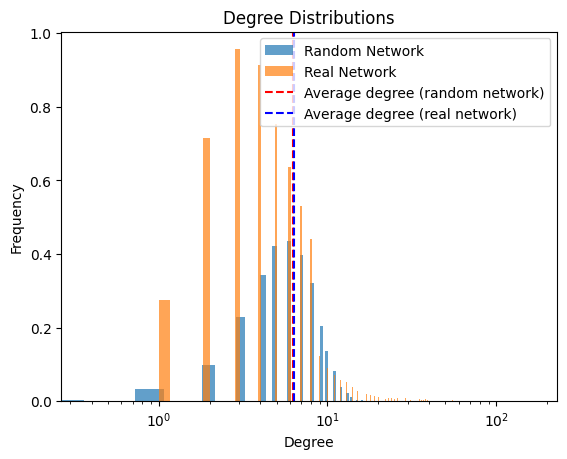

In [7]:
# Compute the degree distribution for the Computational Social Scientists network
degrees_real = [degree for node, degree in G.degree()]

# Compute the degree distribution for the random network
degrees_random = [degree for node, degree in G_random.degree()]

# Plot the degree distributions
plt.figure()
plt.hist(degrees_random, bins=50, density=True, alpha=0.7, label='Random Network')
plt.hist(degrees_real, bins=1000, density=True, alpha=0.7, label='Real Network')

# Add vertical lines for the average degrees
plt.axvline(np.mean(degrees_random), color='r', linestyle='--', label='Average degree (random network)')
plt.axvline(np.mean(degrees_real), color='b', linestyle='--', label='Average degree (real network)')

# log scale the x-axis
plt.xscale('log')
plt.legend()
plt.title('Degree Distributions')
plt.xlabel('Degree')
plt.ylabel('Frequency')
plt.show()

## Part 2 Network Analysis in Computational Social Science

In [35]:
def assortativity_coefficient(G: nx.Graph, attribute: str):
    """
    Function to calculate the degree assortativity coefficient for a given network.

    Args:
        G: nx.Graph, Network to consider
    
    Returns:
        r: float, Degree assortativity coefficient
    """
    
    # Get the degrees of the nodes in the graph
    degrees = {node: degree for node, degree in G.degree()}

    # Get the edge list of the graph
    edge_list = list(G.edges)

    # Get the values of the attribute for each node
    values = nx.get_node_attributes(G, attribute)

    # Create a list of tuples with the degree of the node and the value of the attribute
    degree_value = [(values[key], value) for key, value in degrees.items()]

    # Create a list edges between nodes with the same attribute value
    edges = [(values[edge[0]], 1) for edge in edge_list if values[edge[0]] == values[edge[1]]]

    # Create a dataframe for the edges list
    df_edge = pd.DataFrame(edges, columns=[attribute, 'num_edges'])

    # Compute the number of edges between nodes with the same attribute value
    df_edge = df_edge.groupby(attribute).sum()

    # Create a dataframe from the list of tuples
    df_degree = pd.DataFrame(degree_value, columns=[attribute, 'degree'])

    # Calculate the number of edges between nodes with the same attribute value
    df_degree = df_degree.groupby(attribute).sum()

    # Merge the two dataframes
    df = pd.concat([df_degree, df_edge], axis=1)

    # Fill NaN values with 0
    df = df.fillna(0)

    # Divide each column by the sum of the column
    df['num_edges'] = df['num_edges'] / len(edge_list)
    df['degree'] = df['degree'] / sum(degrees.values())

    # Calculate the degree assortativity coefficient
    r = (df['num_edges'].sum() - df['degree'].pow(2).sum()) / (1 - df['degree'].pow(2).sum())

    return r

In [36]:
# Calculate the degree assortativity of the original network
degree_assortativity = assortativity_coefficient(G, 'country_code')
print("Degree Assortativity of Original Network:", degree_assortativity)

Degree Assortativity of Original Network: 0.4150460386794204


In [37]:
def configuration_model(G: nx.Graph, num_swaps: int):
    """
    Function to generate a configuration model of a given network.

    Args:
        G: nx.Graph, Network to consider
        num_swaps: int, Number of edge swaps to perform
    
    Returns:
        G_new: nx.Graph, Configuration model of the network
    """
    
    # Create an exact copy of the original network
    G_new = deepcopy(G)

    # Create a list of edges and a dictionary of edges for faster lookup
    edges_dict = dict(G_new.edges())
    edges = list(edges_dict.keys())

    swaps = 0
    while swaps < num_swaps:
        # Select two edges
        edges = random.sample(edges, 2)
        e1, e2 = edges[0], edges[1]
        
        # Ensure u != y and v != x
        if e1[0] != e2[1] or e1[1] != e2[0]:

            # Flip the direction of e1 50% of the time
            e1_original = e1
            if random.randint(0, 1) < 0.5:
                e1 = (e1[1], e1[0])

            # Create new edges
            e1_new = (e1[0], e2[1])
            e2_new = (e2[0], e1[1])

            # Check if the new edges already exist in the network
            if edges_dict.get(e1_new) is None and edges_dict.get(e2_new) is None:
                # Remove the old edges and add the new edges
                edges_dict.pop(e1_original)
                edges_dict.pop(e2)
                edges_dict[e1_new] = 1
                edges_dict[e2_new] = 1
                edges.pop(edges.index(e1_original))
                edges.pop(edges.index(e2))
                edges.append(e1_new)
                edges.append(e2_new)
                G_new.remove_edge(*e1_original)
                G_new.remove_edge(*e2)
                G_new.add_edge(*e1_new)
                G_new.add_edge(*e2_new)

                swaps += 1

    return G_new

100%|██████████| 100/100 [04:39<00:00,  2.79s/it]


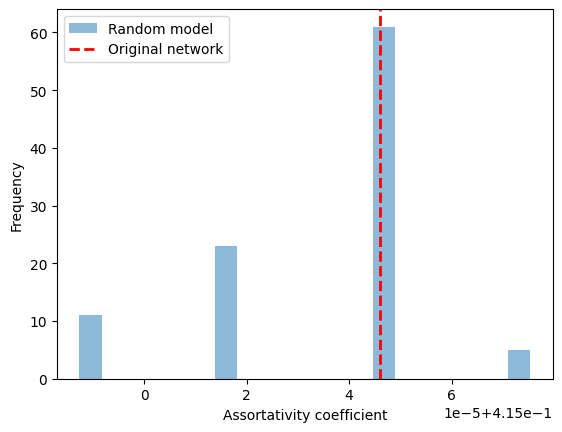

In [38]:
# Calculate the fraction of edges in the new network that connect nodes from the same country
num_edges = G.number_of_edges()
num_networks = 100
assortativity_config = []

for _ in tqdm(range(num_networks)):
    # Generate a random network using the configuration model
    G_config = configuration_model(G, num_edges * 10)

    # Calculate the assortativity of the random network
    assortativity = assortativity_coefficient(G_config, 'country_code')
    assortativity_config.append(assortativity)

# Plot the distribution of assortativity values
plt.hist(assortativity_config, bins=20, alpha=0.5, label='Random model')
plt.axvline(assortativity_coefficient(G, 'country_code'), color='r', linestyle='dashed', linewidth=2, label='Original network')
plt.xlabel('Assortativity coefficient')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [30]:
def degree_assortativity_coefficient(G: nx.Graph):
    """
    Function to calculate the degree assortativity coefficient for a given network.

    Args:
        G: nx.Graph, Network to consider
    
    Returns:
        r: float, Degree assortativity coefficient
    """
    
    # Get all edges
    edges = list(G.edges)

    # Get all u and v values
    u_values, v_values = zip(*edges)

    # Get all degrees
    degrees = dict(G.degree())

    # Get the degree of u and v
    k_u = np.array([degrees[u] for u in u_values])
    k_v = np.array([degrees[v] for v in v_values])

    # Calculate the degree assortativity coefficient
    # r = (np.average(list(degrees.values())) - np.average(k_u) * np.average(k_v)) / (np.sqrt(np.average(k_u ** 2) - np.average(k_u) ** 2) * np.sqrt(np.average(k_v ** 2) - np.average(k_v) ** 2))
    r = (np.mean(k_u * k_v) - np.mean(k_u) * np.mean(k_v)) / (np.sqrt(np.mean(k_u ** 2) - np.mean(k_u) ** 2) * np.sqrt(np.mean(k_v ** 2) - np.mean(k_v) ** 2))

    return r


# Calculate the degree assortativity coefficient of the original network
degree_assortativity = degree_assortativity_coefficient(G)
true_degree_assortativity = nx.degree_assortativity_coefficient(G)
print("Degree assortativity of original network:", degree_assortativity)
print("True degree assortativity of original network:", true_degree_assortativity)

Degree assortativity of original network: 0.014212078841032873
True degree assortativity of original network: -0.112960410365673


100%|██████████| 100/100 [04:53<00:00,  2.93s/it]


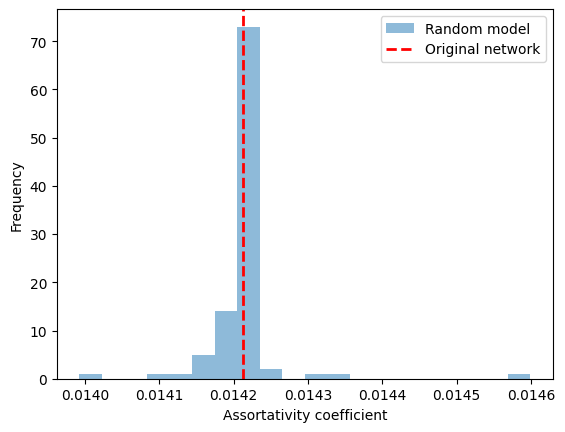

In [39]:
# Calculate the fraction of edges in the new network that connect nodes from the same country
num_edges = G.number_of_edges()
num_networks = 100
degree_assortativity_config = []

for _ in tqdm(range(num_networks)):
    # Generate a random network using the configuration model
    G_config = configuration_model(G, num_edges * 10)

    # Calculate the assortativity of the random network
    degree_assortativity = degree_assortativity_coefficient(G_config)
    degree_assortativity_config.append(degree_assortativity)

# Plot the distribution of assortativity values
plt.hist(degree_assortativity_config, bins=20, alpha=0.5, label='Random model')
plt.axvline(degree_assortativity_coefficient(G), color='r', linestyle='dashed', linewidth=2, label='Original network')
plt.xlabel('Assortativity coefficient')
plt.ylabel('Frequency')
plt.legend()
plt.show()

## Part 3 - Words that characterize Computational Social Science communities

In [10]:
# Load the community data
with open('Week 6/community.json') as f:
    community_dict = json.load(f)

# Convert the dictionary into a DataFrame
df_community = pd.DataFrame(list(community_dict.items()), columns=['author', 'community'])

# Load the degree data
with open('Week 6/degree.json') as f:
    degree_dict = json.load(f)

# Convert the dictionary into a DataFrame
df_degree = pd.DataFrame(list(degree_dict.items()), columns=['author', 'degree'])

# Merge the data
df = df_community.merge(df_degree, on='author')

# Load the abstract data
df_abstract = pd.read_hdf('Week 7/abstracts_processed.hdf5')

# Explode the abstracts to get one row per author id
df_abstract_exploded = df_abstract.explode('author_ids').reset_index(drop=True).rename(columns={'author_ids': 'author'}).dropna(subset=['author'])

# Merge the data
df = df.merge(df_abstract_exploded, on='author')

# Group by 'community' and concatenate all tokens within each community
community_docs = df.groupby('community').aggregate(
    {
        'tokens': lambda x: [token for tokens_list in x for token in tokens_list],
        'degree': 'mean'
    }
)

In [11]:
# Create the CountVectorizer
vectorizer = CountVectorizer()

# Apply it to the 'tokens' column of each community
X = vectorizer.fit_transform(community_docs['tokens'].apply(lambda x: ' '.join(x)))

# Convert the result to a DataFrame
tf = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())

# Sum the term frequencies across all documents for each community
tf_sum = tf.sum(axis=0)

# Sort in descending order and select the top 10 terms
top_terms = tf_sum.sort_values(ascending=False).head(10)
display(top_terms)

the     324219
of      250256
and     197718
to      146177
in      136856
we       81857
that     76275
for      60004
on       54718
is       54702
dtype: int64

In [12]:
# Create the TfidfTransformer
transformer = TfidfTransformer(smooth_idf=True, use_idf=True)

# Apply it to the term frequency matrix
X = transformer.fit_transform(tf.values)

# Convert the result to a DataFrame
idf = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())

# Sum the tf-idf scores across all documents for each community
idf_sum = idf.sum(axis=0)

# Sort in descending order and select the top 10 terms
top_idf = idf_sum.sort_values(ascending=False).head(10)
display(top_idf)

# List the top 3 authors by degree
top_degree = df.sort_values('degree', ascending=False).head(3)
display(top_degree)

the     87.356675
of      62.221882
and     51.165653
to      37.241281
in      35.823495
we      18.986786
that    18.708212
for     17.704549
is      15.801213
on      14.834082
dtype: float64

,author,community,degree,id,title,abstract_inverted_index,text,tokens
13570,https://openalex.org/A5075080019,84,169,https://openalex.org/W2885083199,Finite-time rotating target-encirclement motio...,"{'This': [0], 'paper': [1], 'investigates': [2...",This paper investigates the finite-time rotati...,"[thi_paper, investig, the, finitetim, rotat, t..."
13548,https://openalex.org/A5075080019,84,169,https://openalex.org/W3110264361,The effect of tax avoidance crackdown on corpo...,"{'To': [0], 'constrain': [1], 'the': [2, 22, 4...",To constrain the use of intangible assets in t...,"[to, constrain, the, use, of, intang, asset, i..."
13546,https://openalex.org/A5075080019,84,169,https://openalex.org/W2058712788,Nonconforming finite element approximations of...,"{'The': [0], 'paper': [1], 'deals': [2], 'with...",The paper deals with error estimates and lower...,"[the, paper, deal, with, error, estim, and, lo..."


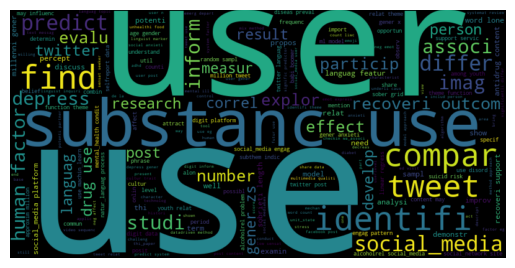

Top authors in community 0: https://openalex.org/A5010646067, https://openalex.org/A5010646067, https://openalex.org/A5010646067


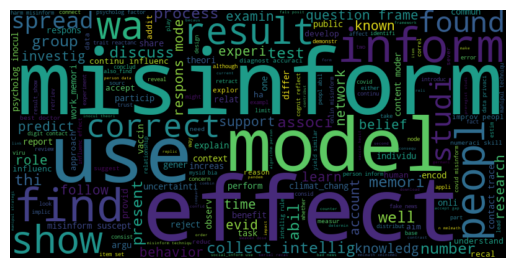

Top authors in community 1: https://openalex.org/A5017914184, https://openalex.org/A5017914184, https://openalex.org/A5017914184


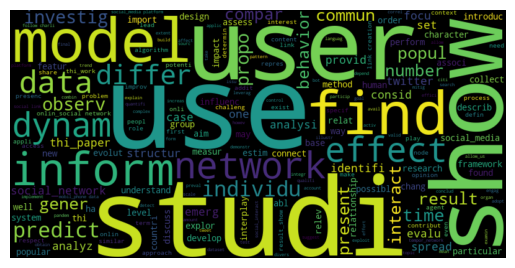

Top authors in community 2: https://openalex.org/A5021346979, https://openalex.org/A5021346979, https://openalex.org/A5021346979


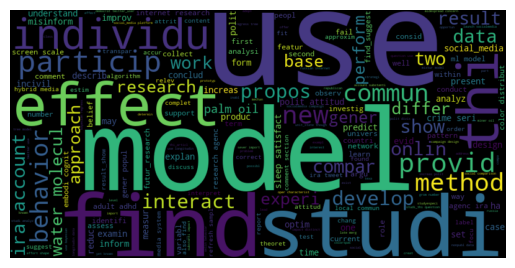

Top authors in community 3: https://openalex.org/A5040468715, https://openalex.org/A5040468715, https://openalex.org/A5040468715


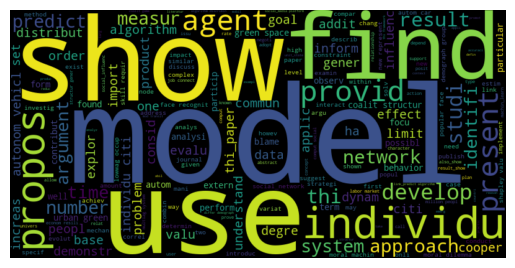

Top authors in community 4: https://openalex.org/A5009232244, https://openalex.org/A5009232244, https://openalex.org/A5009232244


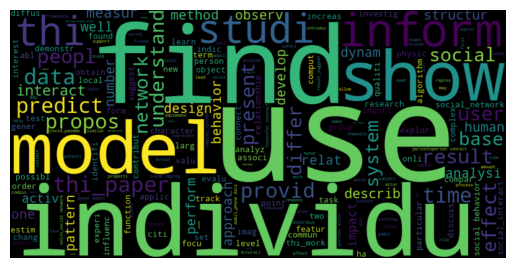

Top authors in community 5: https://openalex.org/A5007176508, https://openalex.org/A5007176508, https://openalex.org/A5007176508


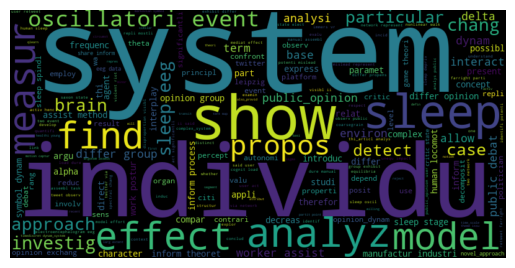

Top authors in community 6: https://openalex.org/A5074755166, https://openalex.org/A5074755166, https://openalex.org/A5074755166


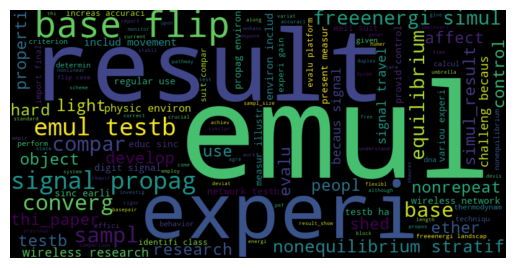

Top authors in community 7: https://openalex.org/A5030909944, https://openalex.org/A5030909944, https://openalex.org/A5027868275


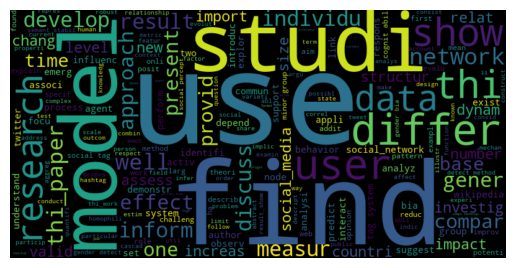

Top authors in community 8: https://openalex.org/A5071422618, https://openalex.org/A5071422618, https://openalex.org/A5071422618


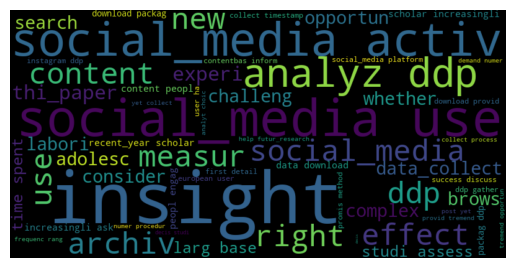

Top authors in community 9: https://openalex.org/A5026212091, https://openalex.org/A5072912426, https://openalex.org/A5029647082


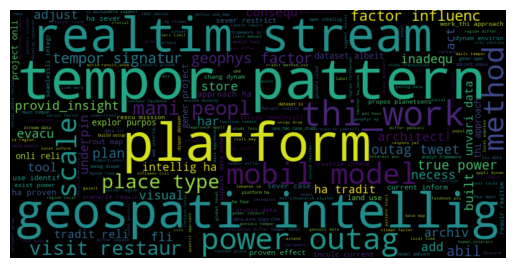

Top authors in community 10: https://openalex.org/A5001338204, https://openalex.org/A5001338204, https://openalex.org/A5001338204


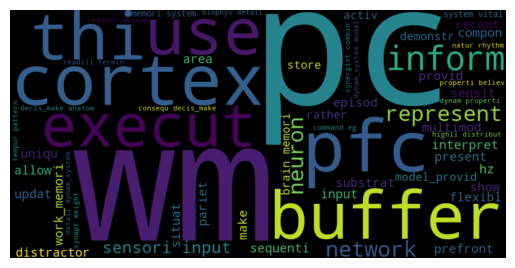

Top authors in community 11: https://openalex.org/A5010352723, https://openalex.org/A5022994404, https://openalex.org/A5077516931


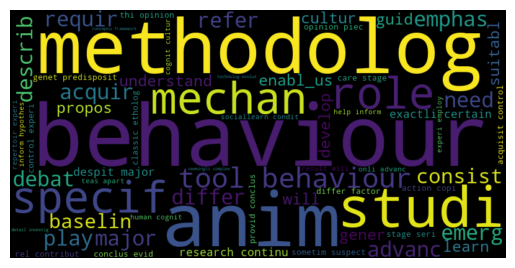

Top authors in community 12: https://openalex.org/A5045118643, https://openalex.org/A5086339706, https://openalex.org/A5017717665


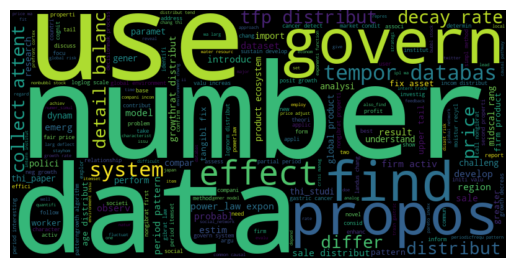

Top authors in community 13: https://openalex.org/A5056438865, https://openalex.org/A5056438865, https://openalex.org/A5056438865


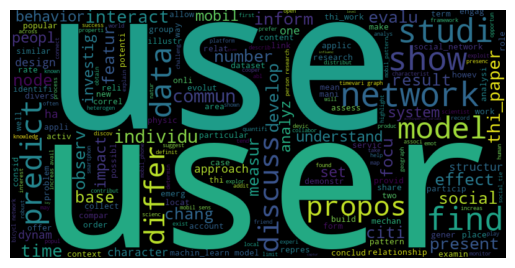

Top authors in community 14: https://openalex.org/A5078886343, https://openalex.org/A5078886343, https://openalex.org/A5078886343


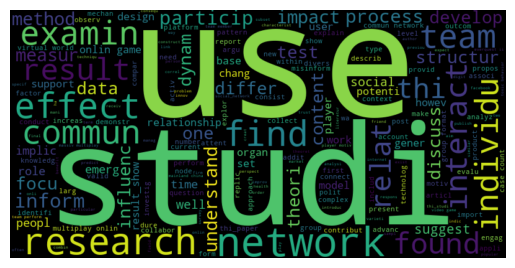

Top authors in community 15: https://openalex.org/A5075283583, https://openalex.org/A5075283583, https://openalex.org/A5075283583


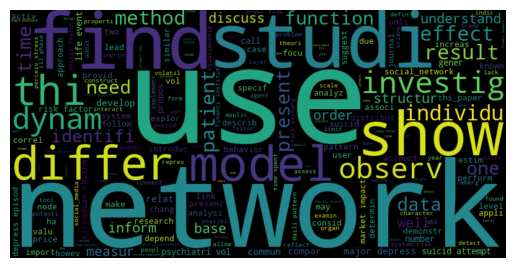

Top authors in community 16: https://openalex.org/A5044033087, https://openalex.org/A5044033087, https://openalex.org/A5044033087


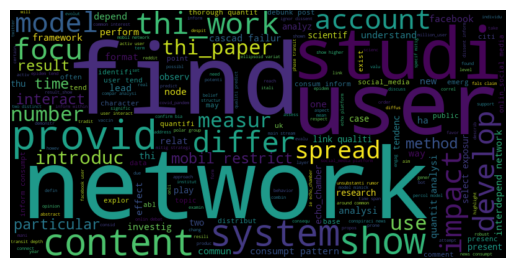

Top authors in community 17: https://openalex.org/A5008291667, https://openalex.org/A5008291667, https://openalex.org/A5008291667


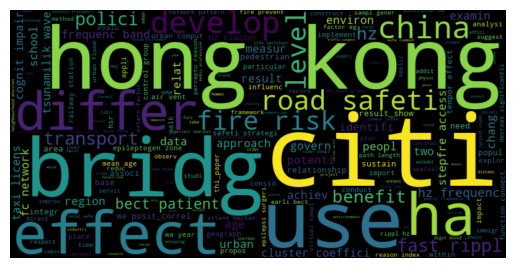

Top authors in community 18: https://openalex.org/A5066649557, https://openalex.org/A5066649557, https://openalex.org/A5066649557


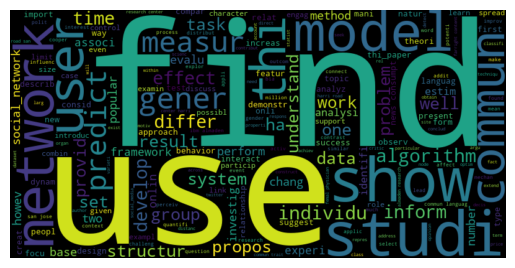

Top authors in community 19: https://openalex.org/A5087088138, https://openalex.org/A5087088138, https://openalex.org/A5087088138


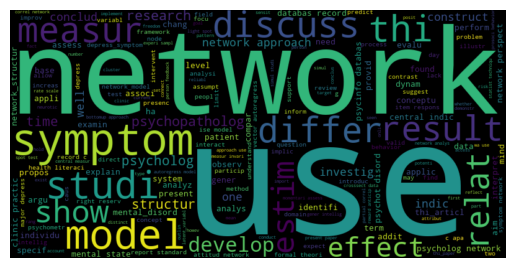

Top authors in community 20: https://openalex.org/A5029100305, https://openalex.org/A5029100305, https://openalex.org/A5029100305


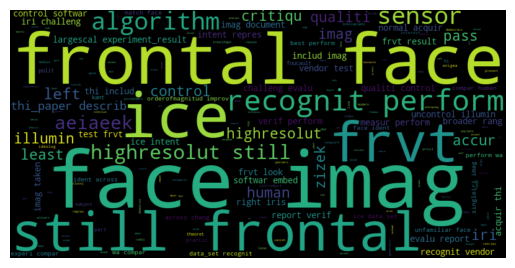

Top authors in community 21: https://openalex.org/A5018181018, https://openalex.org/A5018181018, https://openalex.org/A5018181018


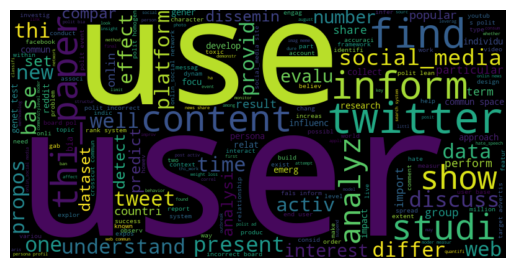

Top authors in community 22: https://openalex.org/A5061923992, https://openalex.org/A5061923992, https://openalex.org/A5061923992


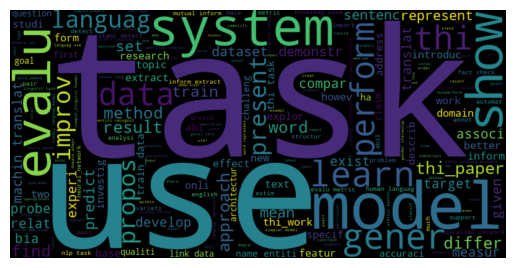

Top authors in community 23: https://openalex.org/A5061951606, https://openalex.org/A5061951606, https://openalex.org/A5061951606


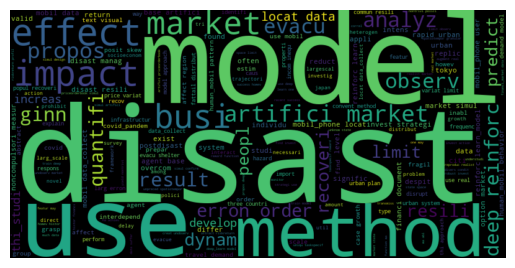

Top authors in community 24: https://openalex.org/A5044205949, https://openalex.org/A5044205949, https://openalex.org/A5044205949


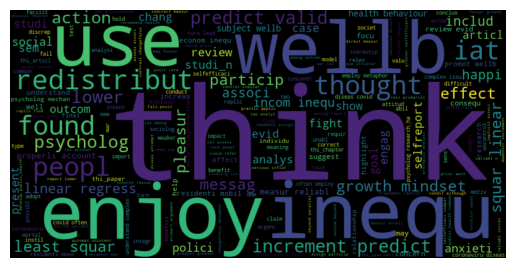

Top authors in community 25: https://openalex.org/A5047385425, https://openalex.org/A5047385425, https://openalex.org/A5047385425


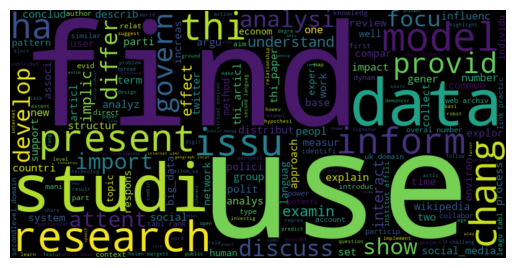

Top authors in community 26: https://openalex.org/A5067625837, https://openalex.org/A5067625837, https://openalex.org/A5067625837


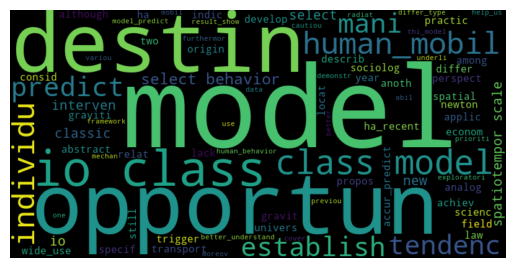

Top authors in community 27: https://openalex.org/A5077515904, https://openalex.org/A5062610763


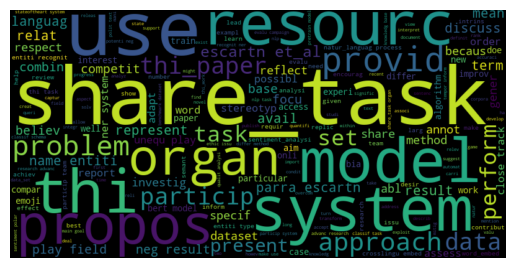

Top authors in community 28: https://openalex.org/A5017409996, https://openalex.org/A5017409996, https://openalex.org/A5017409996


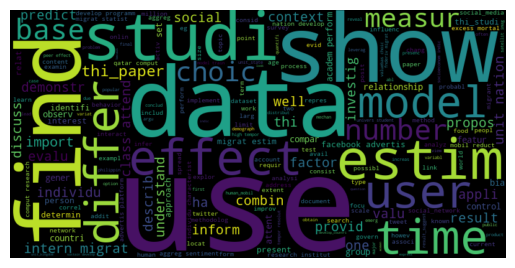

Top authors in community 29: https://openalex.org/A5033656008, https://openalex.org/A5033656008, https://openalex.org/A5033656008


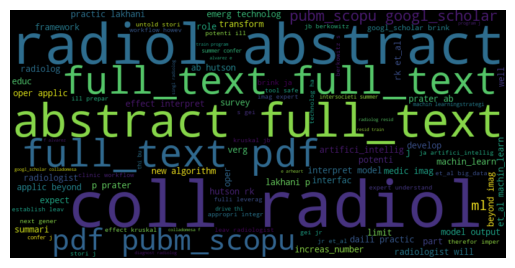

Top authors in community 30: https://openalex.org/A5047611362, https://openalex.org/A5054432618, https://openalex.org/A5005696882


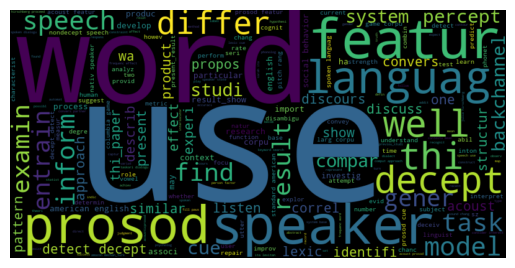

Top authors in community 31: https://openalex.org/A5045037642, https://openalex.org/A5045037642, https://openalex.org/A5045037642


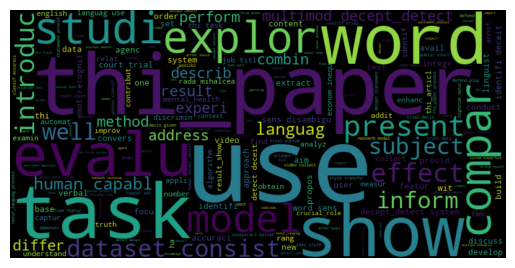

Top authors in community 32: https://openalex.org/A5082450455, https://openalex.org/A5082450455, https://openalex.org/A5082450455


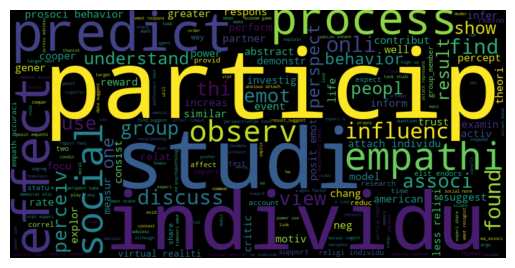

Top authors in community 33: https://openalex.org/A5047315859, https://openalex.org/A5047315859, https://openalex.org/A5047315859


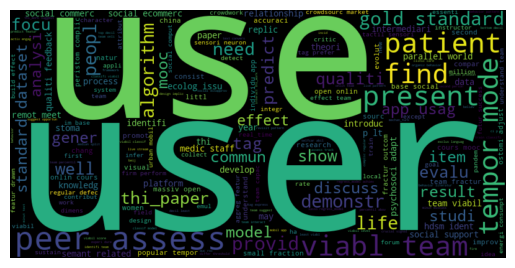

Top authors in community 34: https://openalex.org/A5088335237, https://openalex.org/A5088335237, https://openalex.org/A5088335237


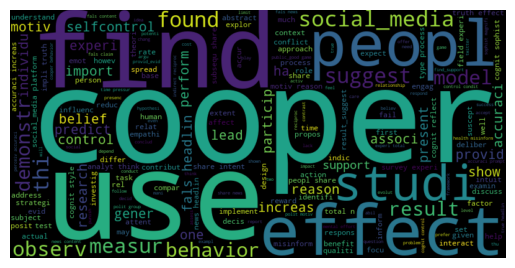

Top authors in community 35: https://openalex.org/A5056499434, https://openalex.org/A5056499434, https://openalex.org/A5056499434


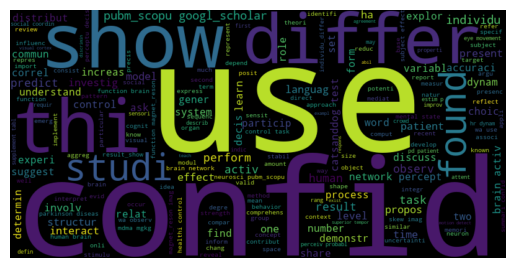

Top authors in community 36: https://openalex.org/A5005493160, https://openalex.org/A5005493160, https://openalex.org/A5005493160


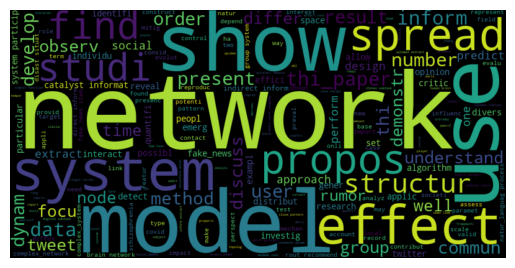

Top authors in community 37: https://openalex.org/A5034372799, https://openalex.org/A5034372799, https://openalex.org/A5034372799


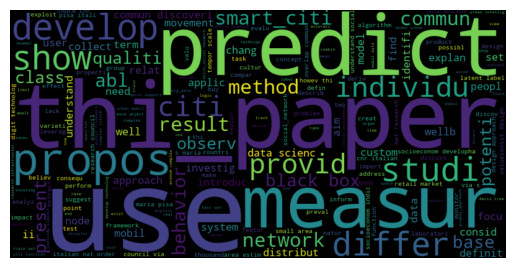

Top authors in community 38: https://openalex.org/A5024505700, https://openalex.org/A5024505700, https://openalex.org/A5024505700


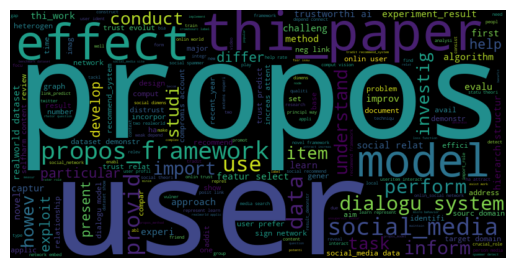

Top authors in community 39: https://openalex.org/A5040639891, https://openalex.org/A5040639891, https://openalex.org/A5040639891


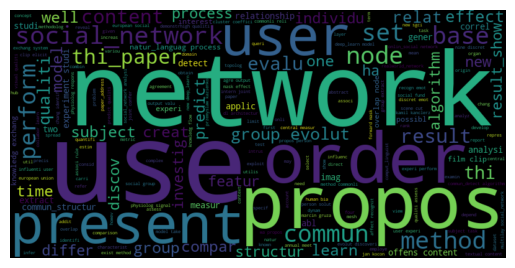

Top authors in community 40: https://openalex.org/A5049612210, https://openalex.org/A5049612210, https://openalex.org/A5049612210


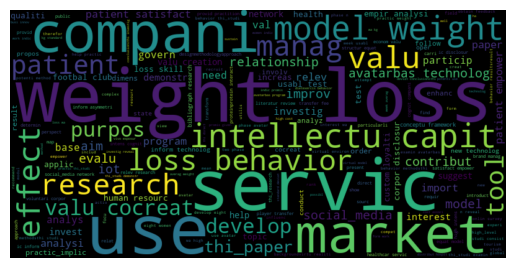

Top authors in community 41: https://openalex.org/A5052040863, https://openalex.org/A5052040863, https://openalex.org/A5052040863


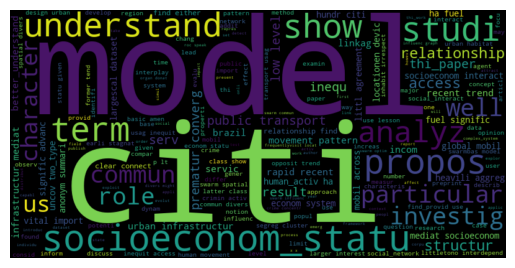

Top authors in community 42: https://openalex.org/A5033081182, https://openalex.org/A5033081182, https://openalex.org/A5033081182


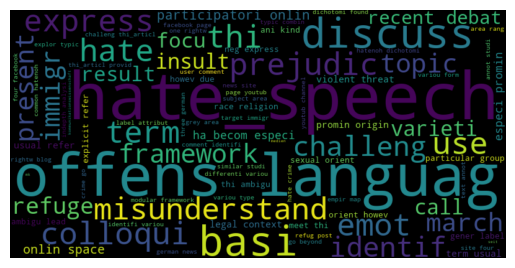

Top authors in community 43: https://openalex.org/A5012631395, https://openalex.org/A5079530226, https://openalex.org/A5049721869


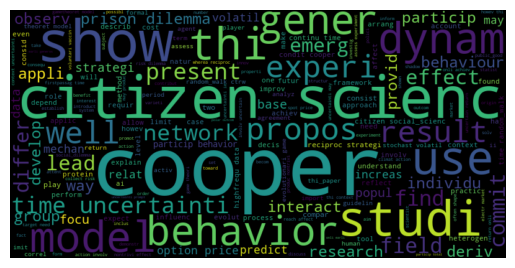

Top authors in community 44: https://openalex.org/A5093039163, https://openalex.org/A5093039163, https://openalex.org/A5093039163


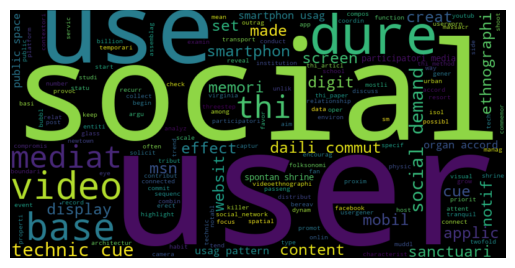

Top authors in community 45: https://openalex.org/A5016401839, https://openalex.org/A5016401839, https://openalex.org/A5024176058


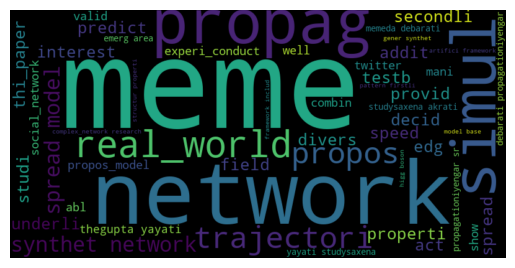

Top authors in community 46: https://openalex.org/A5080507324, https://openalex.org/A5004420568, https://openalex.org/A5055236010


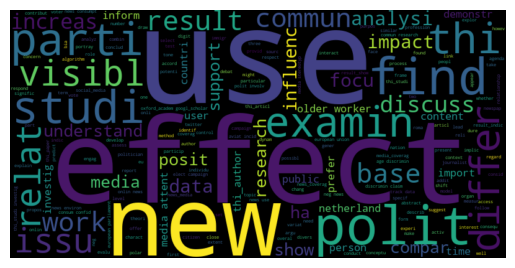

Top authors in community 47: https://openalex.org/A5077381667, https://openalex.org/A5077381667, https://openalex.org/A5077381667


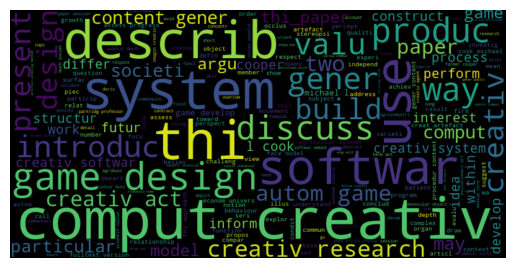

Top authors in community 48: https://openalex.org/A5084471568, https://openalex.org/A5084471568, https://openalex.org/A5084471568


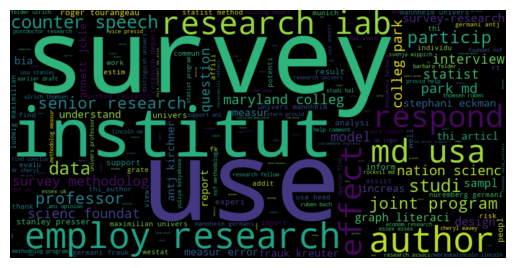

Top authors in community 49: https://openalex.org/A5038390320, https://openalex.org/A5038390320, https://openalex.org/A5038390320


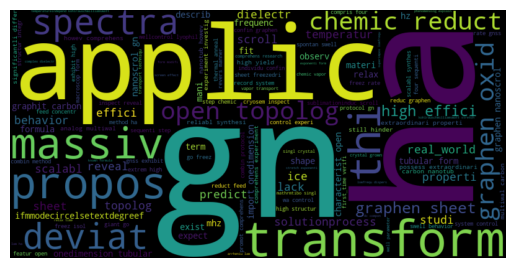

Top authors in community 50: https://openalex.org/A5007994819, https://openalex.org/A5007994819, https://openalex.org/A5085934487


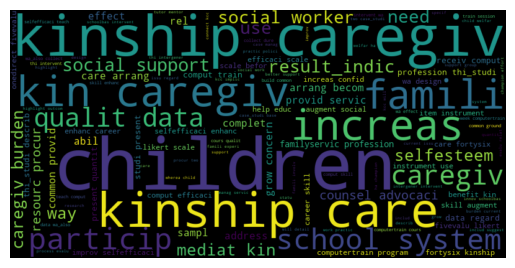

Top authors in community 51: https://openalex.org/A5015211752, https://openalex.org/A5015211752, https://openalex.org/A5006307162


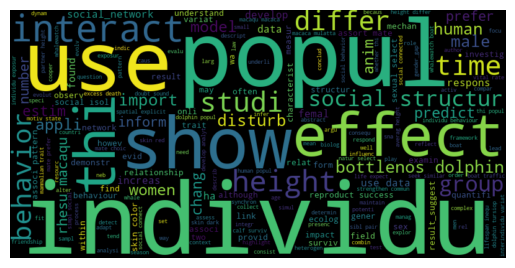

Top authors in community 52: https://openalex.org/A5017444948, https://openalex.org/A5017444948, https://openalex.org/A5017444948


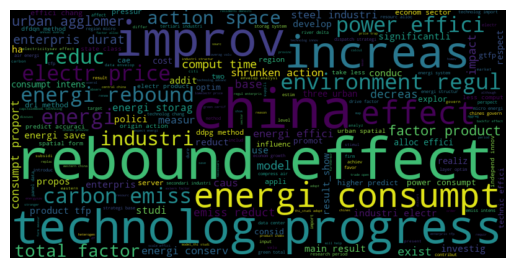

Top authors in community 53: https://openalex.org/A5080163144, https://openalex.org/A5080163144, https://openalex.org/A5080163144


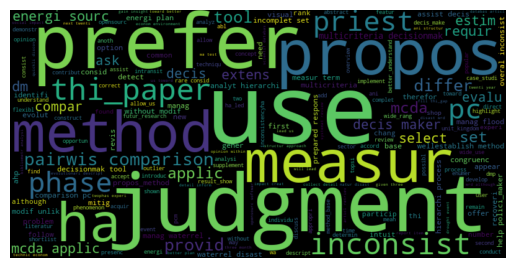

Top authors in community 54: https://openalex.org/A5024786684, https://openalex.org/A5024786684, https://openalex.org/A5024786684


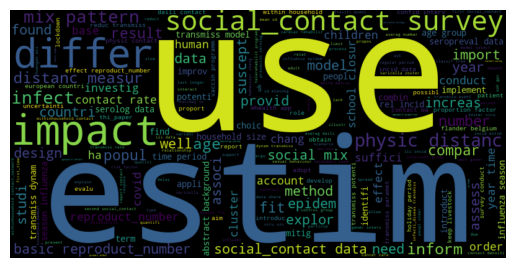

Top authors in community 55: https://openalex.org/A5042663607, https://openalex.org/A5042663607, https://openalex.org/A5042663607


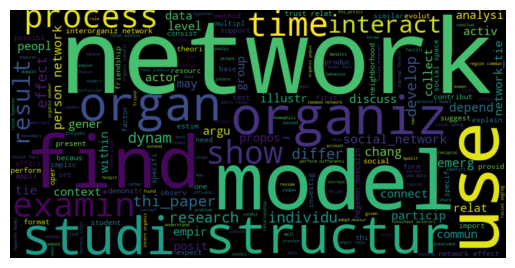

Top authors in community 56: https://openalex.org/A5018108132, https://openalex.org/A5018108132, https://openalex.org/A5018108132


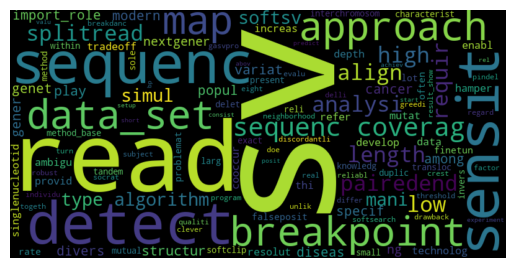

Top authors in community 57: https://openalex.org/A5002071945, https://openalex.org/A5062364819


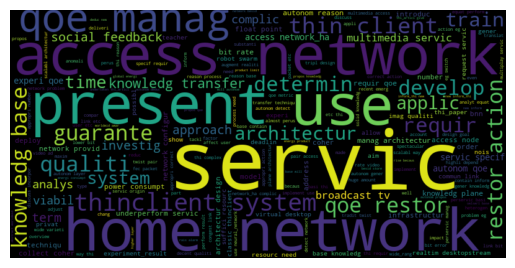

Top authors in community 58: https://openalex.org/A5001314520, https://openalex.org/A5001314520, https://openalex.org/A5001314520


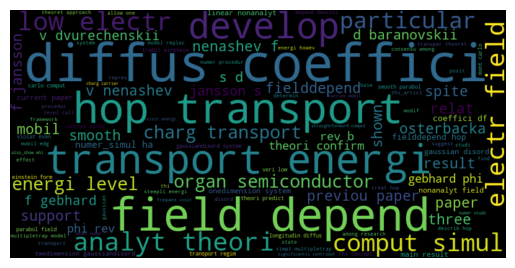

Top authors in community 59: https://openalex.org/A5022455238, https://openalex.org/A5031250931, https://openalex.org/A5031250931


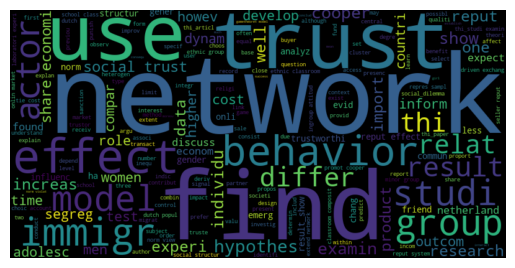

Top authors in community 61: https://openalex.org/A5023426397, https://openalex.org/A5023426397, https://openalex.org/A5023426397


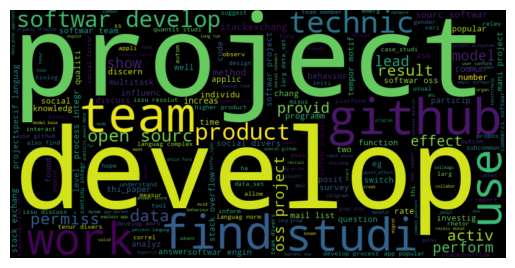

Top authors in community 62: https://openalex.org/A5064626129, https://openalex.org/A5064626129, https://openalex.org/A5064626129


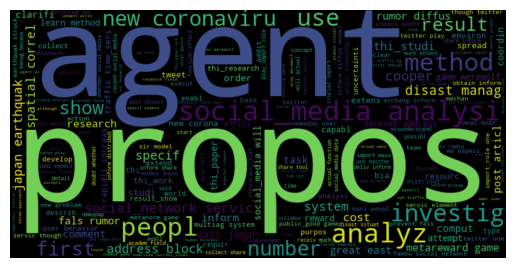

Top authors in community 63: https://openalex.org/A5040217228, https://openalex.org/A5040217228, https://openalex.org/A5040217228


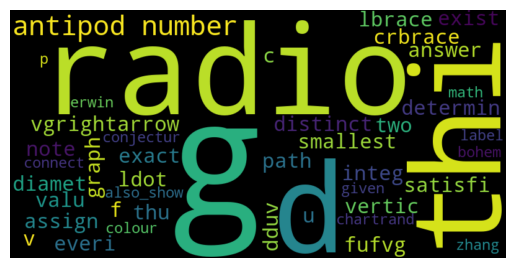

Top authors in community 64: https://openalex.org/A5045655458, https://openalex.org/A5011275718


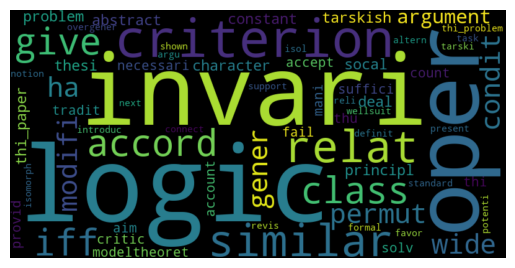

Top authors in community 65: https://openalex.org/A5058810080


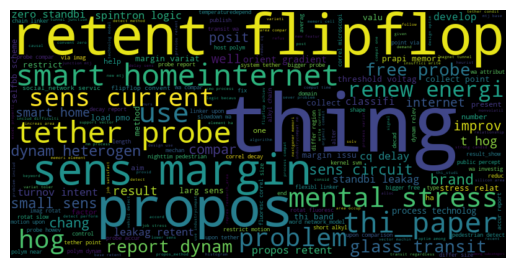

Top authors in community 66: https://openalex.org/A5083716771, https://openalex.org/A5083716771, https://openalex.org/A5083716771


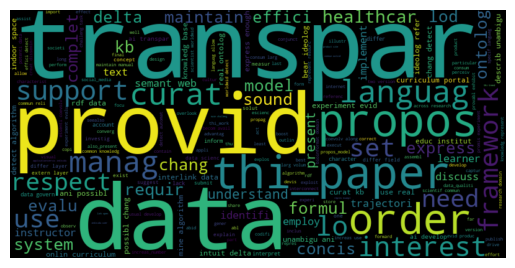

Top authors in community 67: https://openalex.org/A5009316832, https://openalex.org/A5009316832, https://openalex.org/A5009316832


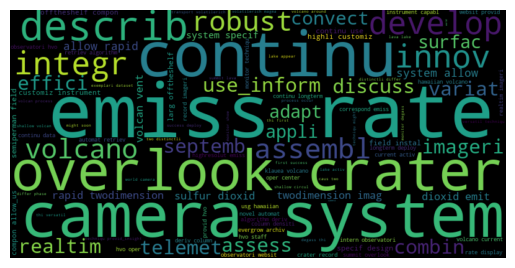

Top authors in community 69: https://openalex.org/A5037204027, https://openalex.org/A5044778419, https://openalex.org/A5062401133


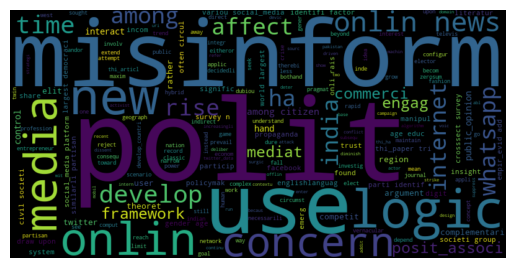

Top authors in community 70: https://openalex.org/A5076382635, https://openalex.org/A5076382635, https://openalex.org/A5076382635


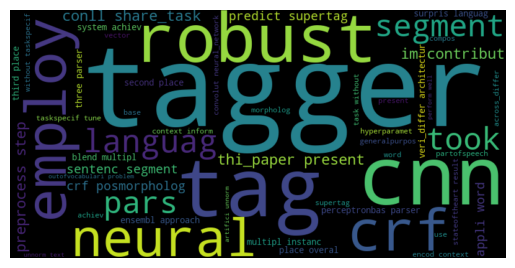

Top authors in community 71: https://openalex.org/A5004381930, https://openalex.org/A5004381930, https://openalex.org/A5037220308


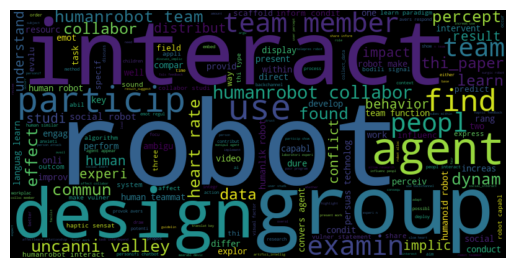

Top authors in community 72: https://openalex.org/A5069608785, https://openalex.org/A5069608785, https://openalex.org/A5069608785


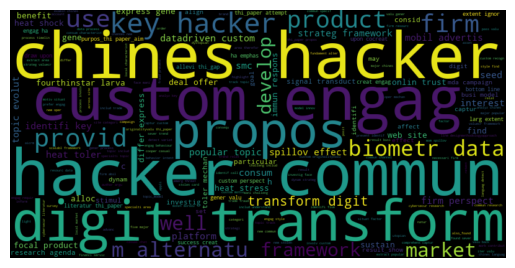

Top authors in community 73: https://openalex.org/A5073502448, https://openalex.org/A5073502448, https://openalex.org/A5073502448


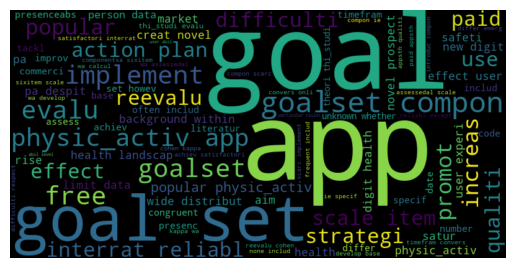

Top authors in community 74: https://openalex.org/A5034410008, https://openalex.org/A5034410008, https://openalex.org/A5061227329


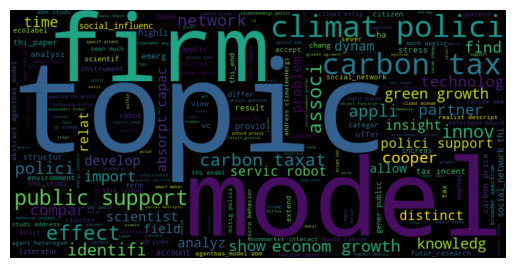

Top authors in community 75: https://openalex.org/A5025144355, https://openalex.org/A5025144355, https://openalex.org/A5025144355


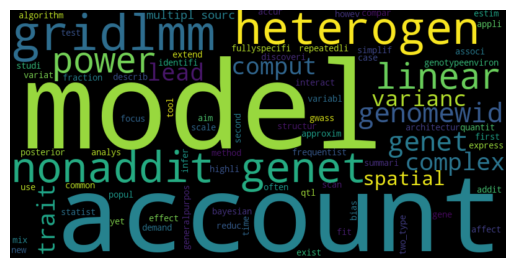

Top authors in community 76: https://openalex.org/A5033244104, https://openalex.org/A5079313615


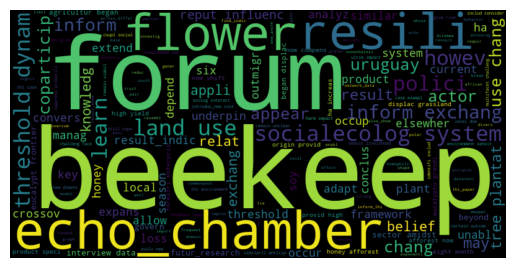

Top authors in community 77: https://openalex.org/A5044956842, https://openalex.org/A5044956842, https://openalex.org/A5065998818


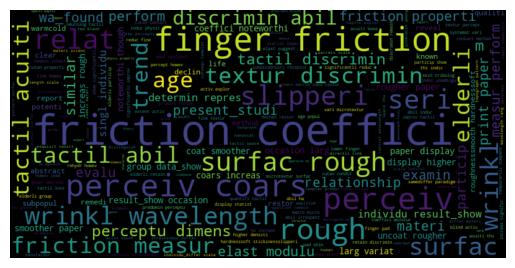

Top authors in community 79: https://openalex.org/A5008643048, https://openalex.org/A5008643048, https://openalex.org/A5008643048


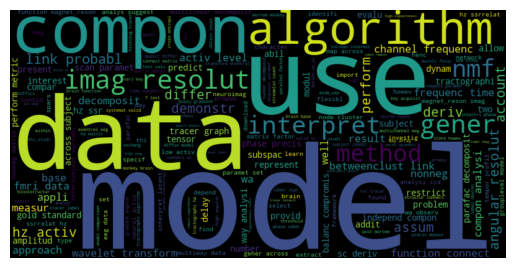

Top authors in community 80: https://openalex.org/A5059840085, https://openalex.org/A5059840085, https://openalex.org/A5059840085


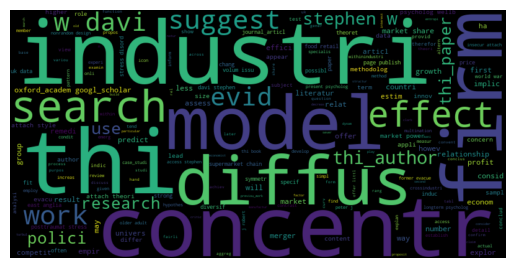

Top authors in community 81: https://openalex.org/A5060895838, https://openalex.org/A5060895838, https://openalex.org/A5060895838


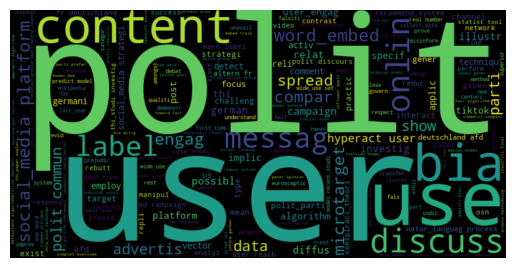

Top authors in community 82: https://openalex.org/A5061502731, https://openalex.org/A5061502731, https://openalex.org/A5061502731


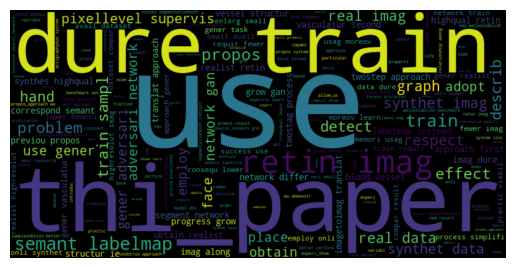

Top authors in community 83: https://openalex.org/A5091787895, https://openalex.org/A5091787895, https://openalex.org/A5091787895


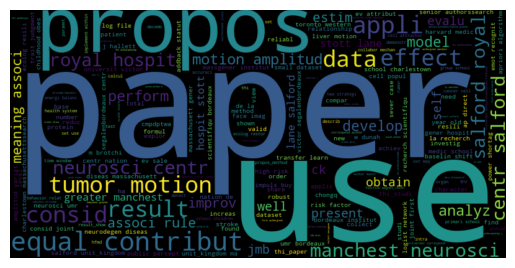

Top authors in community 84: https://openalex.org/A5075080019, https://openalex.org/A5075080019, https://openalex.org/A5075080019


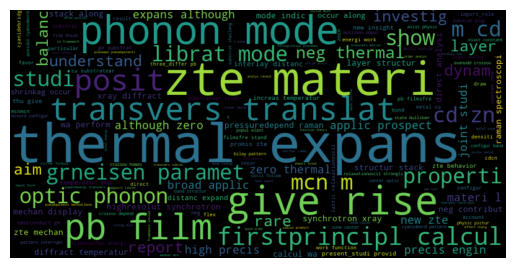

Top authors in community 85: https://openalex.org/A5081165962, https://openalex.org/A5081165962, https://openalex.org/A5081165962


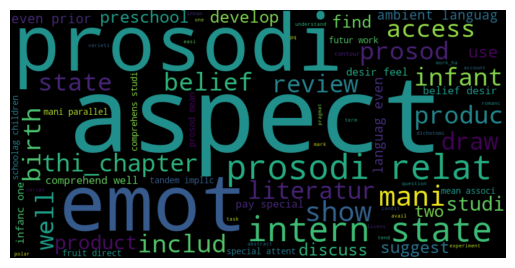

Top authors in community 86: https://openalex.org/A5079371673, https://openalex.org/A5009987572, https://openalex.org/A5015599068


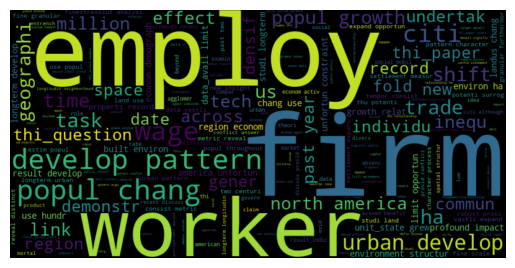

Top authors in community 87: https://openalex.org/A5073838075, https://openalex.org/A5073838075, https://openalex.org/A5073838075


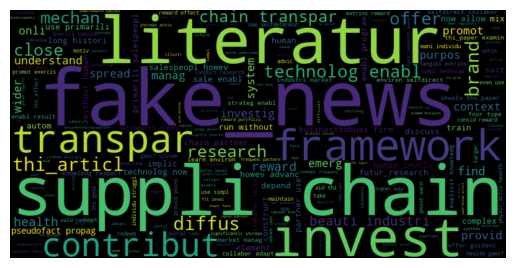

Top authors in community 88: https://openalex.org/A5066138111, https://openalex.org/A5066138111, https://openalex.org/A5066138111


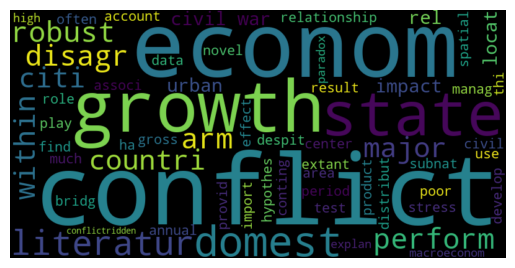

Top authors in community 89: https://openalex.org/A5089637526, https://openalex.org/A5037841475


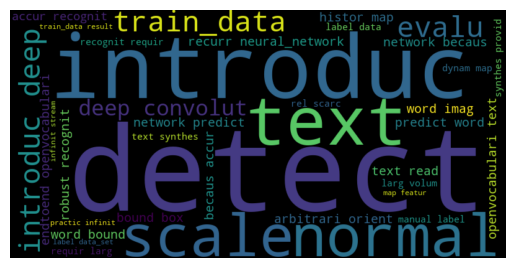

Top authors in community 90: https://openalex.org/A5042570943, https://openalex.org/A5075132945, https://openalex.org/A5046234163


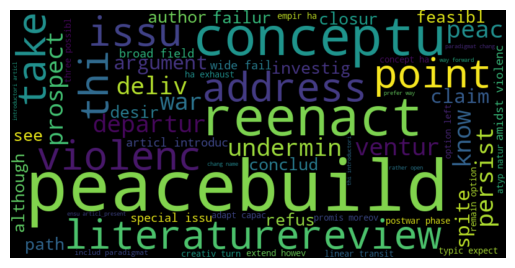

Top authors in community 91: https://openalex.org/A5029845004, https://openalex.org/A5027137927, https://openalex.org/A5061627648


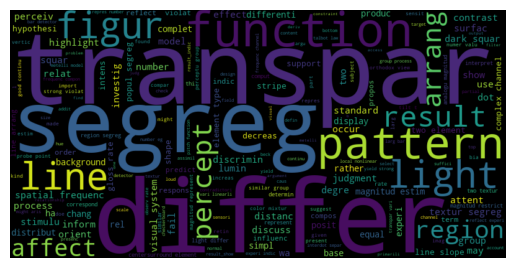

Top authors in community 92: https://openalex.org/A5025141355, https://openalex.org/A5025141355, https://openalex.org/A5025141355


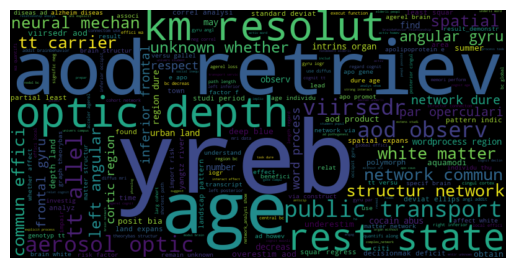

Top authors in community 93: https://openalex.org/A5062844781, https://openalex.org/A5062844781, https://openalex.org/A5062844781


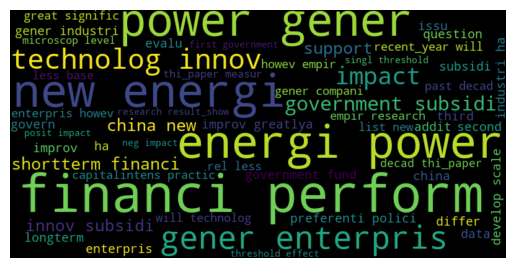

Top authors in community 94: https://openalex.org/A5022876276, https://openalex.org/A5067028141, https://openalex.org/A5005813769


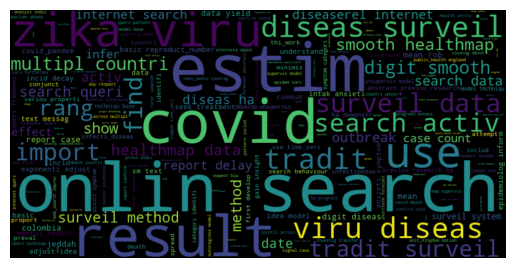

Top authors in community 95: https://openalex.org/A5060277811, https://openalex.org/A5060277811, https://openalex.org/A5060277811


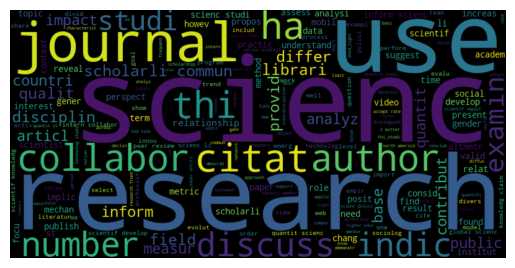

Top authors in community 96: https://openalex.org/A5029483412, https://openalex.org/A5029483412, https://openalex.org/A5029483412


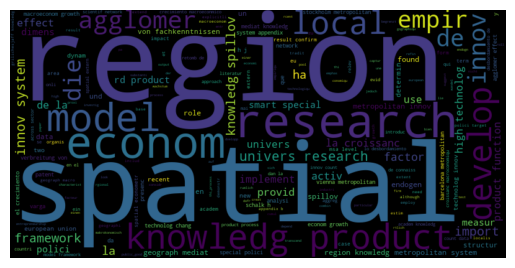

Top authors in community 97: https://openalex.org/A5065544460, https://openalex.org/A5065544460, https://openalex.org/A5065544460


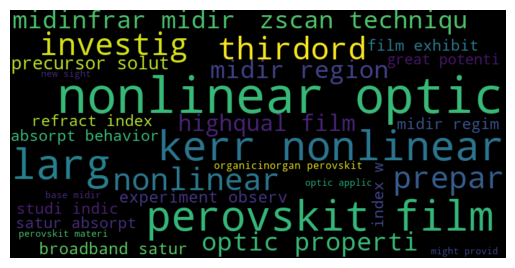

Top authors in community 98: https://openalex.org/A5026163142, https://openalex.org/A5020782361, https://openalex.org/A5023058682


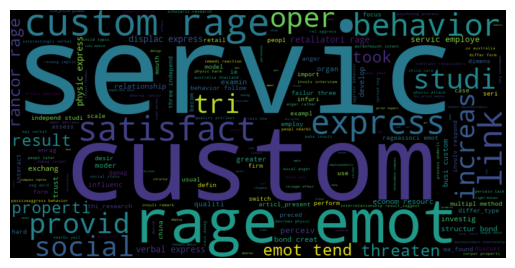

Top authors in community 99: https://openalex.org/A5010691256, https://openalex.org/A5010691256, https://openalex.org/A5010691256


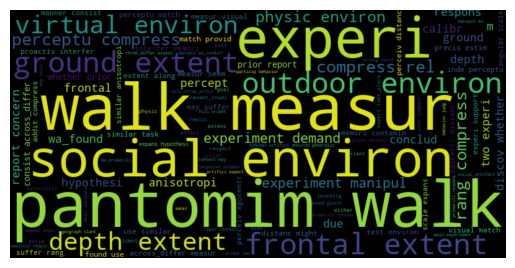

Top authors in community 100: https://openalex.org/A5045709001, https://openalex.org/A5045709001, https://openalex.org/A5077965506


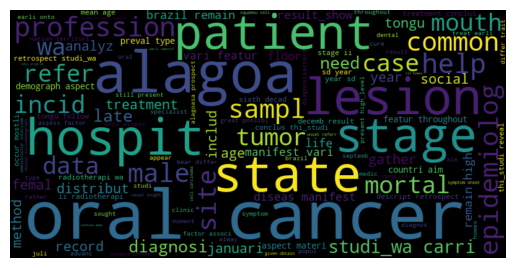

Top authors in community 101: https://openalex.org/A5042296299, https://openalex.org/A5042296299, https://openalex.org/A5022552949


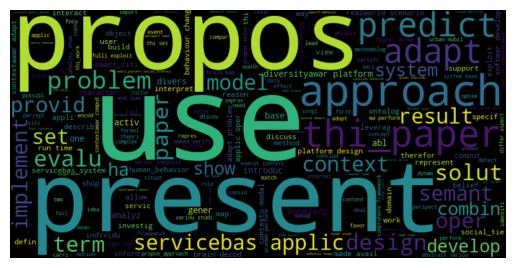

Top authors in community 102: https://openalex.org/A5001227032, https://openalex.org/A5001227032, https://openalex.org/A5001227032


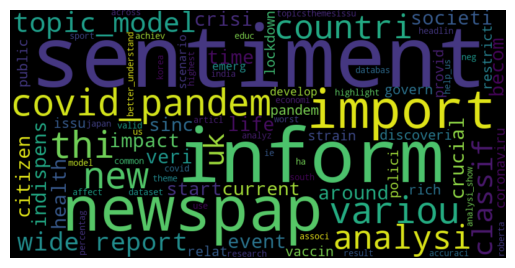

Top authors in community 103: https://openalex.org/A5083816730, https://openalex.org/A5042644425


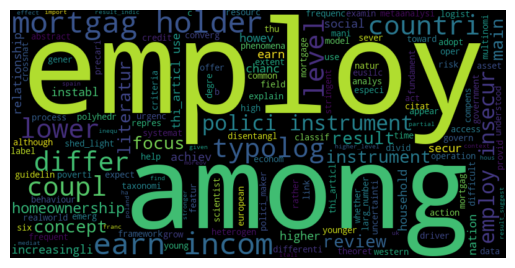

Top authors in community 104: https://openalex.org/A5060256587, https://openalex.org/A5060256587, https://openalex.org/A5015346324


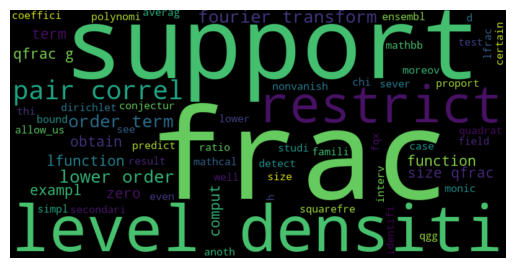

Top authors in community 105: https://openalex.org/A5038304782, https://openalex.org/A5038217519


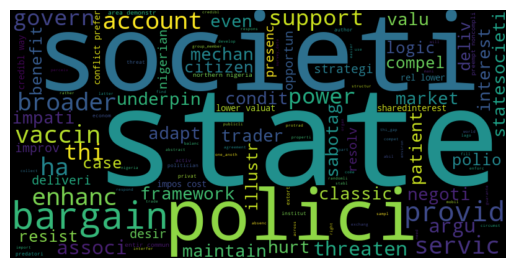

Top authors in community 106: https://openalex.org/A5030406488, https://openalex.org/A5030406488, https://openalex.org/A5063237850


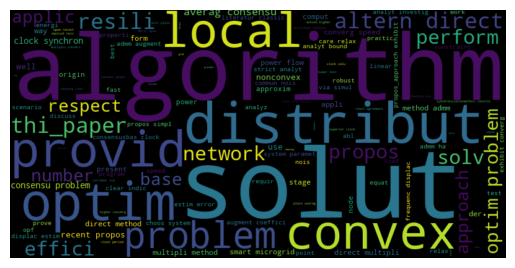

Top authors in community 107: https://openalex.org/A5066420511, https://openalex.org/A5066420511, https://openalex.org/A5066420511


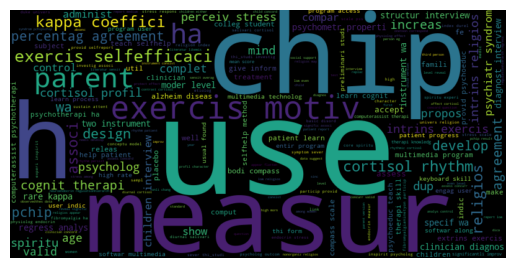

Top authors in community 108: https://openalex.org/A5009325217, https://openalex.org/A5009325217, https://openalex.org/A5009325217


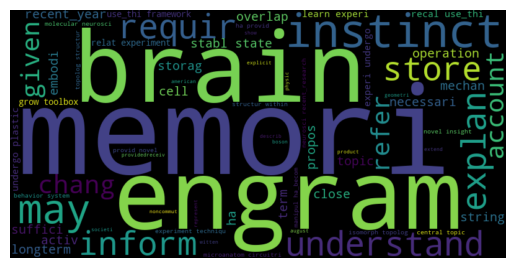

Top authors in community 110: https://openalex.org/A5050252738, https://openalex.org/A5050252738, https://openalex.org/A5021509895


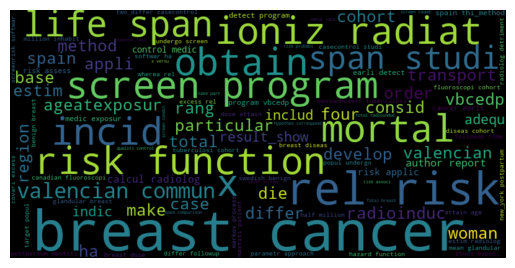

Top authors in community 111: https://openalex.org/A5004870383, https://openalex.org/A5012678897, https://openalex.org/A5022448878


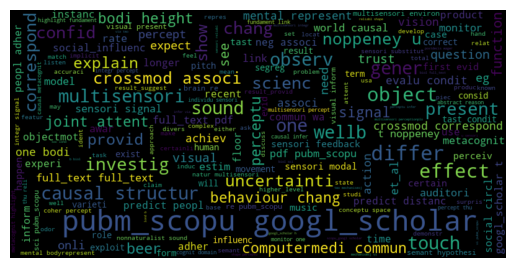

Top authors in community 112: https://openalex.org/A5035021472, https://openalex.org/A5035021472, https://openalex.org/A5035021472


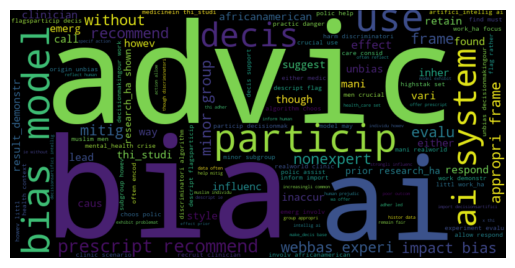

Top authors in community 113: https://openalex.org/A5070063054, https://openalex.org/A5081889692, https://openalex.org/A5039868033


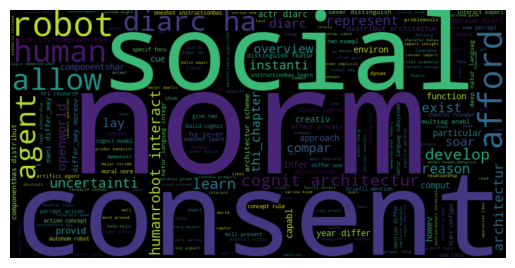

Top authors in community 114: https://openalex.org/A5071988241, https://openalex.org/A5071988241, https://openalex.org/A5071988241


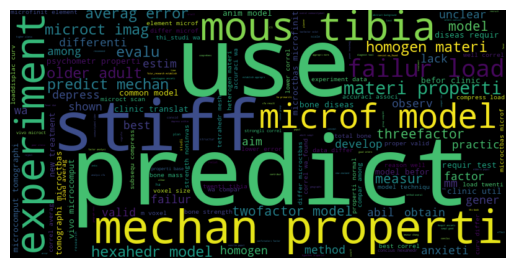

Top authors in community 115: https://openalex.org/A5046618110, https://openalex.org/A5046618110, https://openalex.org/A5046618110


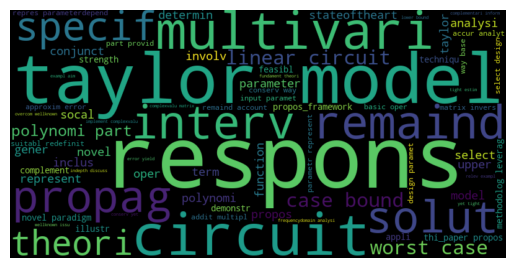

Top authors in community 116: https://openalex.org/A5011446833, https://openalex.org/A5022195747, https://openalex.org/A5010639399


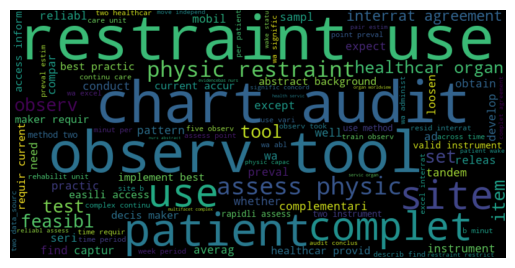

Top authors in community 117: https://openalex.org/A5025559460, https://openalex.org/A5070654915, https://openalex.org/A5052688905


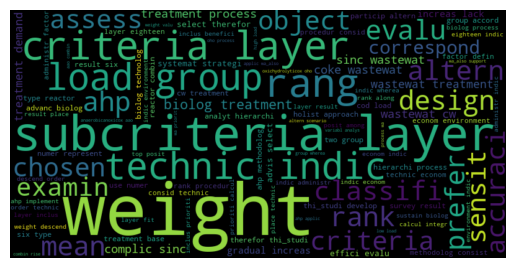

Top authors in community 118: https://openalex.org/A5085814944, https://openalex.org/A5045789277, https://openalex.org/A5063840122


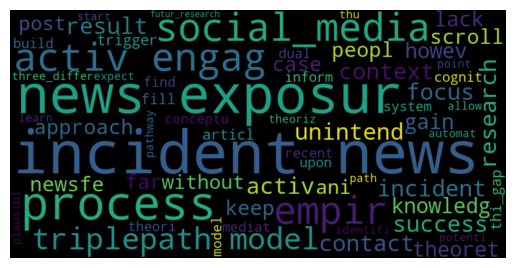

Top authors in community 119: https://openalex.org/A5086981709, https://openalex.org/A5086243139


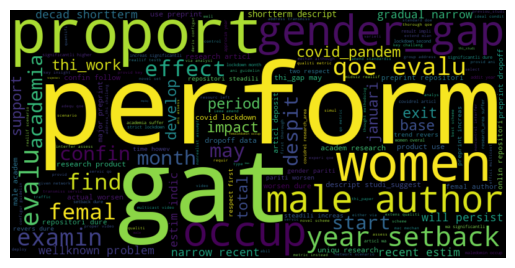

Top authors in community 120: https://openalex.org/A5072498572, https://openalex.org/A5072498572, https://openalex.org/A5072498572


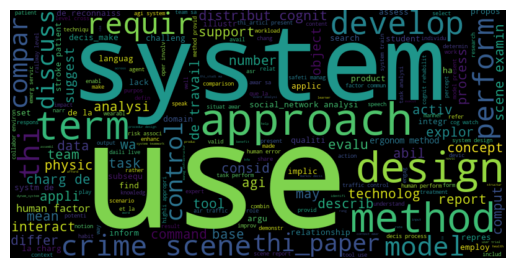

Top authors in community 121: https://openalex.org/A5080376515, https://openalex.org/A5080376515, https://openalex.org/A5080376515


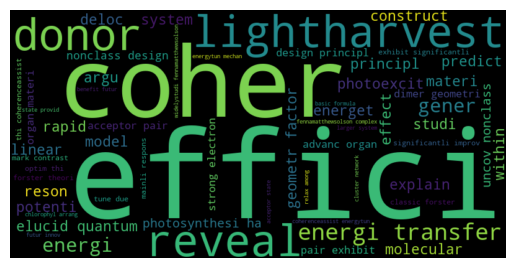

Top authors in community 122: https://openalex.org/A5069764052, https://openalex.org/A5069995009, https://openalex.org/A5074241509


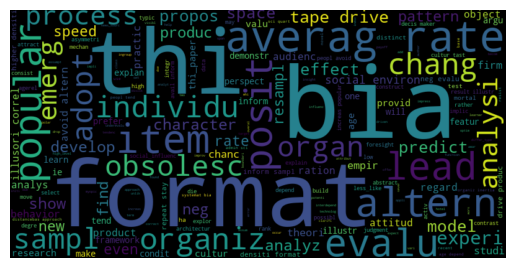

Top authors in community 123: https://openalex.org/A5074137374, https://openalex.org/A5074137374, https://openalex.org/A5074137374


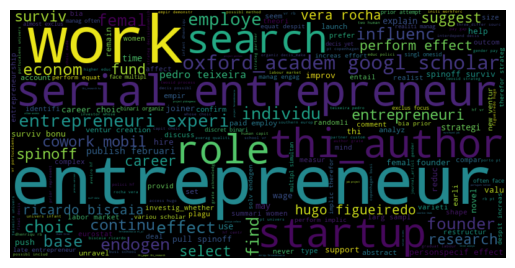

Top authors in community 124: https://openalex.org/A5034405667, https://openalex.org/A5034405667, https://openalex.org/A5034405667


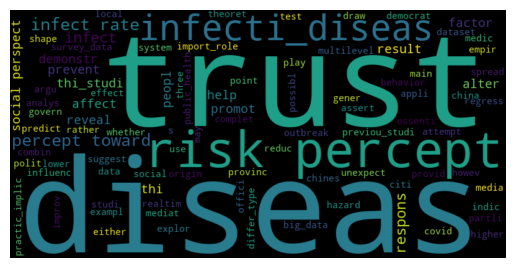

Top authors in community 125: https://openalex.org/A5085932729, https://openalex.org/A5069533167


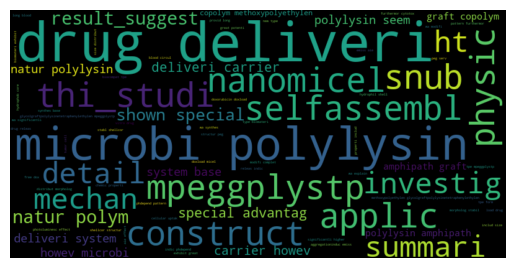

Top authors in community 126: https://openalex.org/A5063913041, https://openalex.org/A5083646645, https://openalex.org/A5040712147


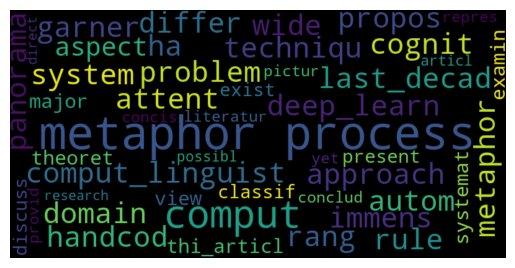

Top authors in community 127: https://openalex.org/A5082861306, https://openalex.org/A5014435955


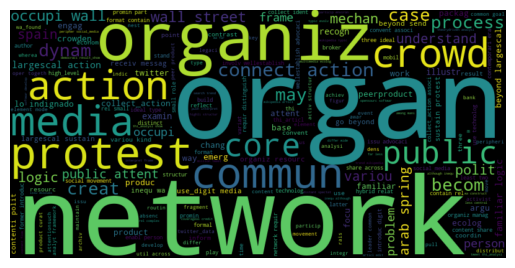

Top authors in community 128: https://openalex.org/A5054478253, https://openalex.org/A5054478253, https://openalex.org/A5054478253


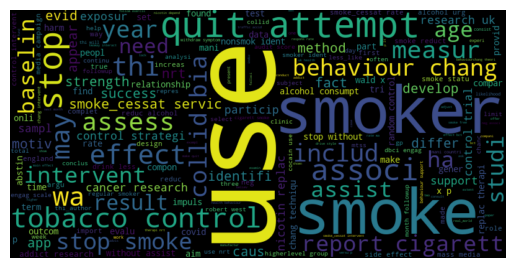

Top authors in community 129: https://openalex.org/A5064290037, https://openalex.org/A5064290037, https://openalex.org/A5064290037


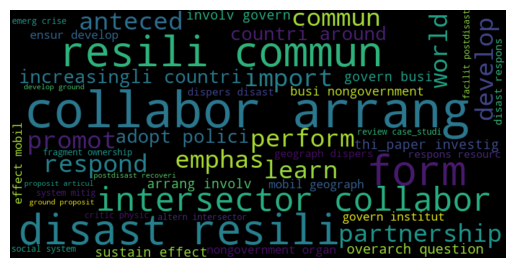

Top authors in community 130: https://openalex.org/A5043583247, https://openalex.org/A5021922894, https://openalex.org/A5051597957


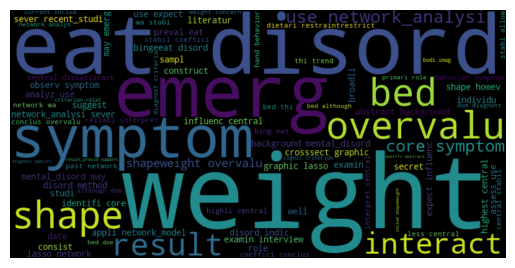

Top authors in community 131: https://openalex.org/A5062341708, https://openalex.org/A5081336074, https://openalex.org/A5034204065


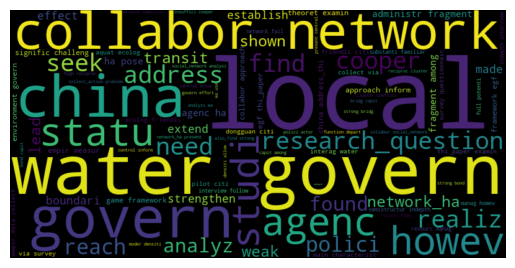

Top authors in community 132: https://openalex.org/A5002323911, https://openalex.org/A5021838428, https://openalex.org/A5006712471


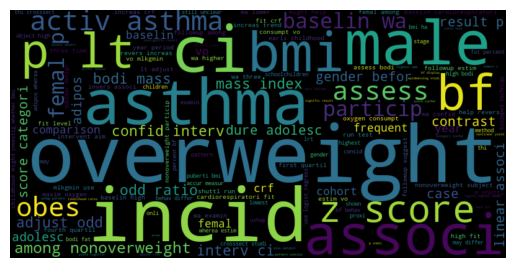

Top authors in community 133: https://openalex.org/A5000566142, https://openalex.org/A5000566142, https://openalex.org/A5087607093


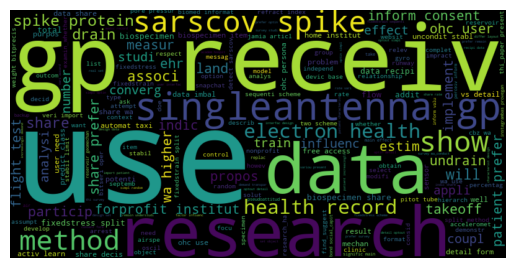

Top authors in community 134: https://openalex.org/A5037234320, https://openalex.org/A5037234320, https://openalex.org/A5037234320


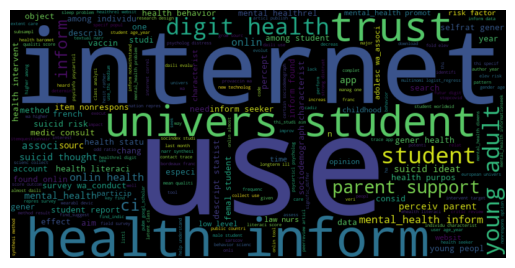

Top authors in community 135: https://openalex.org/A5050372797, https://openalex.org/A5050372797, https://openalex.org/A5050372797


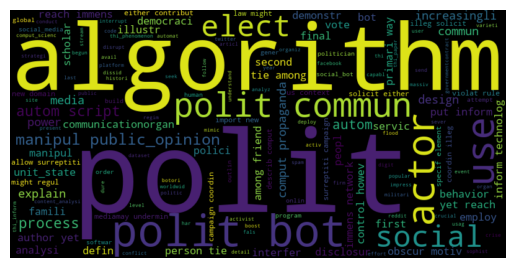

Top authors in community 136: https://openalex.org/A5079636968, https://openalex.org/A5028631384, https://openalex.org/A5028631384


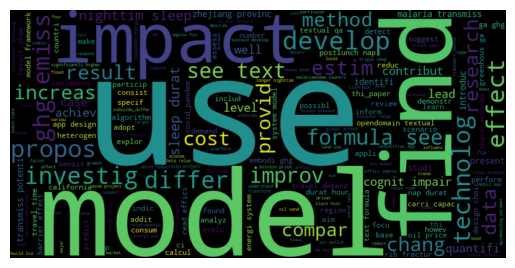

Top authors in community 137: https://openalex.org/A5040523461, https://openalex.org/A5040523461, https://openalex.org/A5040523461


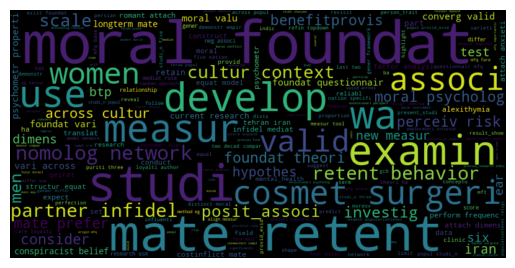

Top authors in community 138: https://openalex.org/A5015311126, https://openalex.org/A5015311126, https://openalex.org/A5015311126


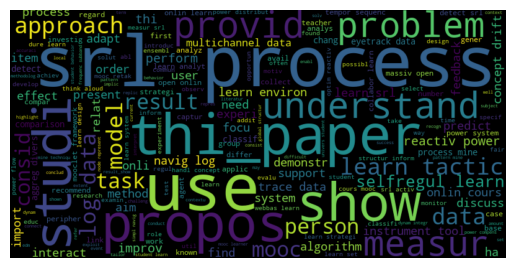

Top authors in community 139: https://openalex.org/A5022601535, https://openalex.org/A5022601535, https://openalex.org/A5022601535


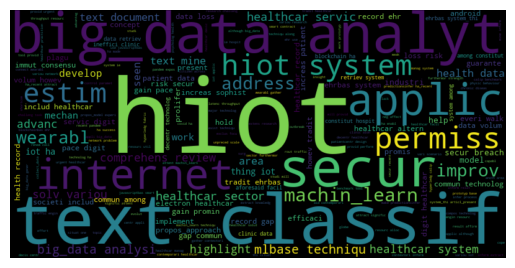

Top authors in community 140: https://openalex.org/A5000043933, https://openalex.org/A5000043933, https://openalex.org/A5000043933


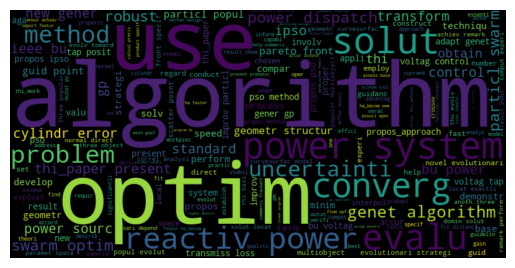

Top authors in community 141: https://openalex.org/A5046276657, https://openalex.org/A5046276657, https://openalex.org/A5046276657


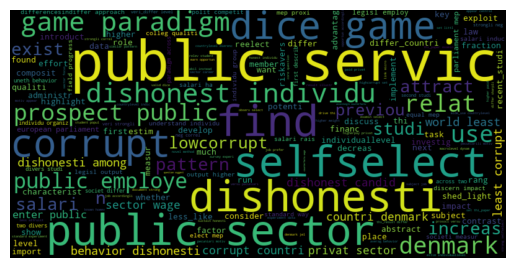

Top authors in community 142: https://openalex.org/A5084537405, https://openalex.org/A5084537405, https://openalex.org/A5084537405


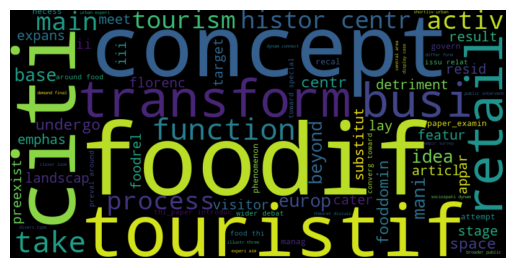

Top authors in community 143: https://openalex.org/A5005941967, https://openalex.org/A5068201653, https://openalex.org/A5041505286


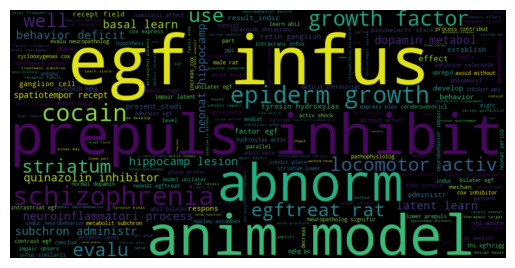

Top authors in community 144: https://openalex.org/A5011126050, https://openalex.org/A5011126050, https://openalex.org/A5011126050


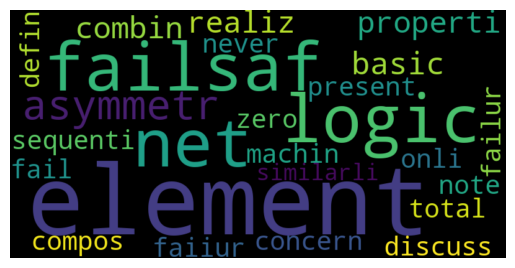

Top authors in community 145: https://openalex.org/A5070799203, https://openalex.org/A5046097382, https://openalex.org/A5051428004


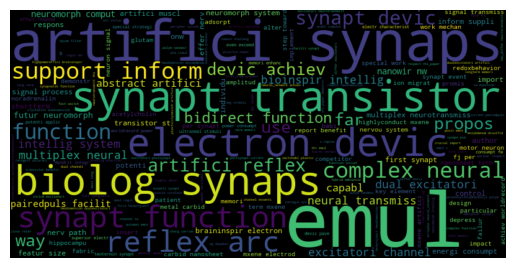

Top authors in community 146: https://openalex.org/A5022647373, https://openalex.org/A5022647373, https://openalex.org/A5022647373


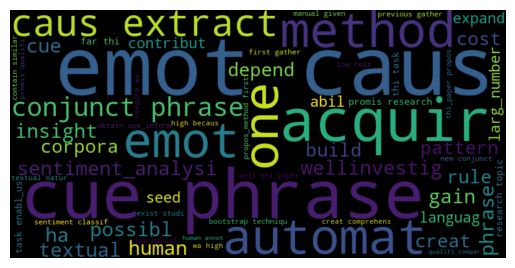

Top authors in community 147: https://openalex.org/A5051981195, https://openalex.org/A5053493294, https://openalex.org/A5062709079


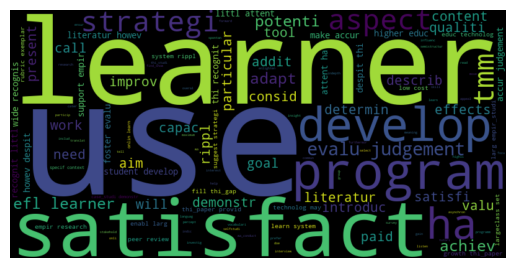

Top authors in community 148: https://openalex.org/A5072883637, https://openalex.org/A5072883637, https://openalex.org/A5069874026


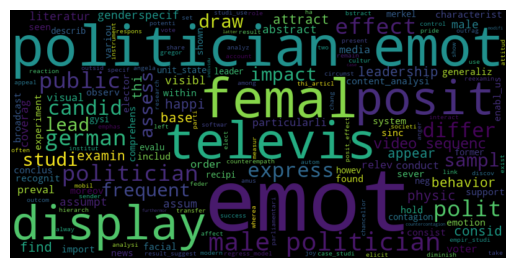

Top authors in community 149: https://openalex.org/A5088397418, https://openalex.org/A5079177338, https://openalex.org/A5079177338


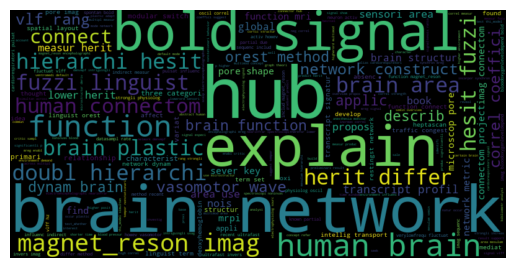

Top authors in community 150: https://openalex.org/A5089186571, https://openalex.org/A5089186571, https://openalex.org/A5089186571


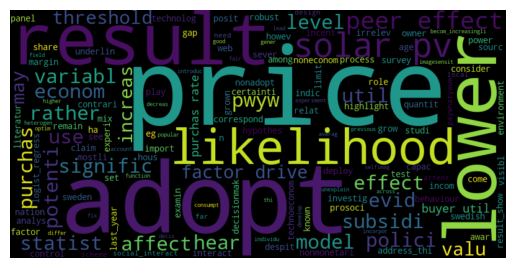

Top authors in community 151: https://openalex.org/A5035471852, https://openalex.org/A5035471852, https://openalex.org/A5066818775


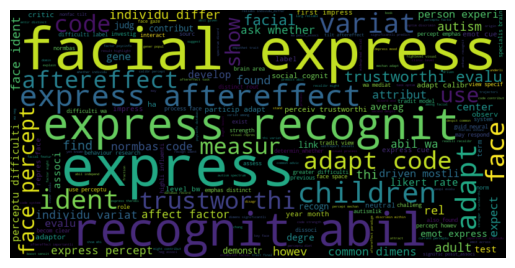

Top authors in community 152: https://openalex.org/A5054138313, https://openalex.org/A5054138313, https://openalex.org/A5054138313


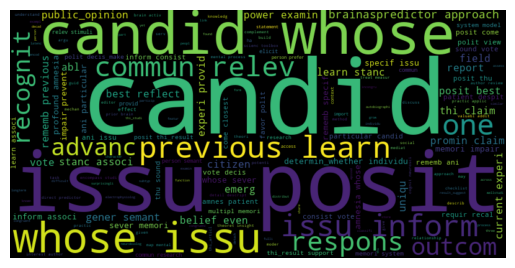

Top authors in community 153: https://openalex.org/A5035084501, https://openalex.org/A5035084501, https://openalex.org/A5035084501


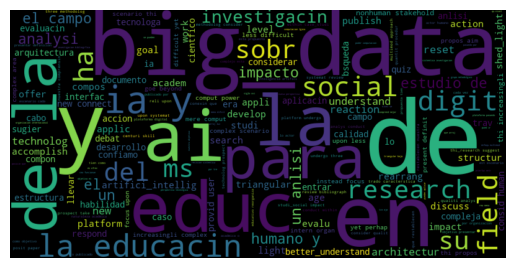

Top authors in community 154: https://openalex.org/A5032257766, https://openalex.org/A5046284320, https://openalex.org/A5036106869


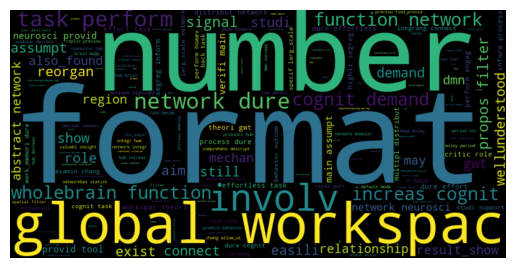

Top authors in community 155: https://openalex.org/A5064738197, https://openalex.org/A5064738197, https://openalex.org/A5081855156


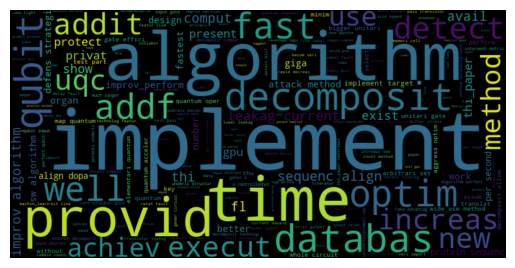

Top authors in community 156: https://openalex.org/A5021955713, https://openalex.org/A5021955713, https://openalex.org/A5021955713


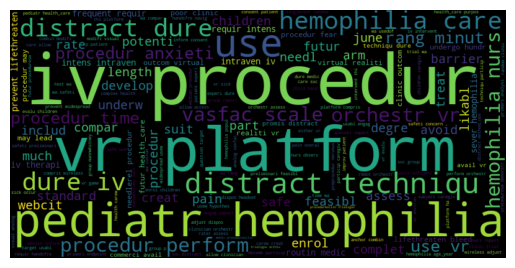

Top authors in community 157: https://openalex.org/A5006140886, https://openalex.org/A5033341922, https://openalex.org/A5039159288


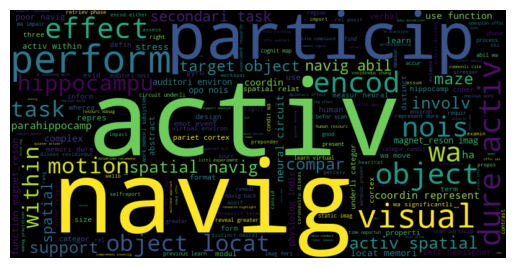

Top authors in community 158: https://openalex.org/A5012434331, https://openalex.org/A5012434331, https://openalex.org/A5012434331


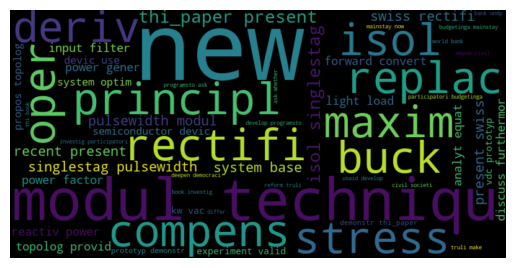

Top authors in community 159: https://openalex.org/A5072574591, https://openalex.org/A5072574591, https://openalex.org/A5007778843


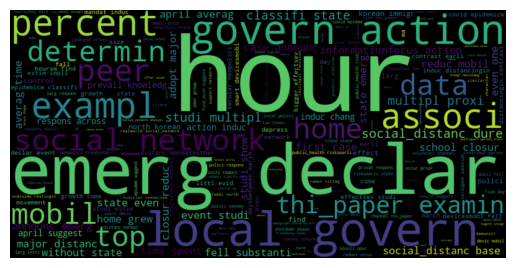

Top authors in community 160: https://openalex.org/A5066089123, https://openalex.org/A5066089123, https://openalex.org/A5066089123


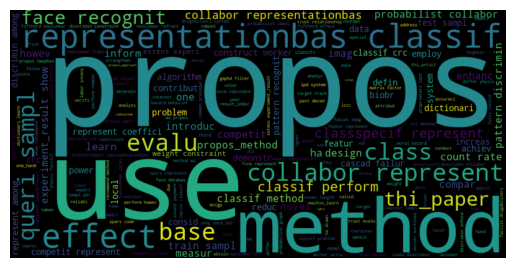

Top authors in community 161: https://openalex.org/A5055757510, https://openalex.org/A5055757510, https://openalex.org/A5055757510


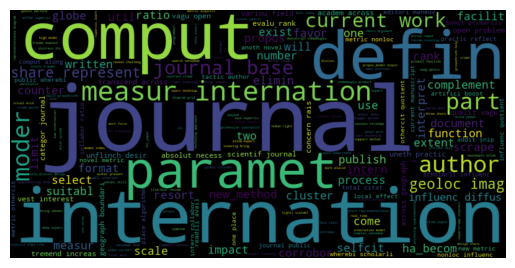

Top authors in community 162: https://openalex.org/A5007675088, https://openalex.org/A5007675088, https://openalex.org/A5007675088


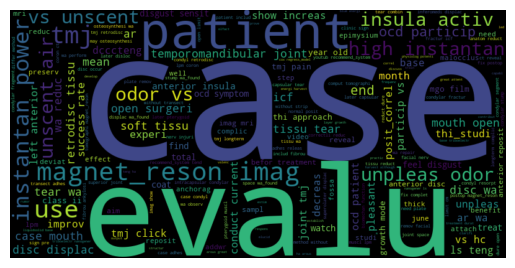

Top authors in community 163: https://openalex.org/A5061970875, https://openalex.org/A5061970875, https://openalex.org/A5061970875


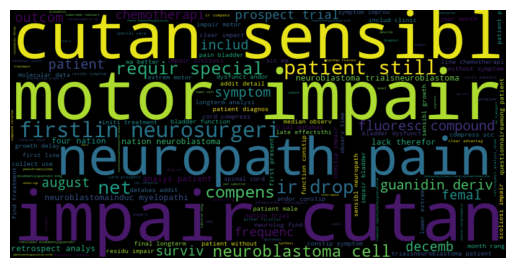

Top authors in community 164: https://openalex.org/A5046328006, https://openalex.org/A5046328006, https://openalex.org/A5046328006


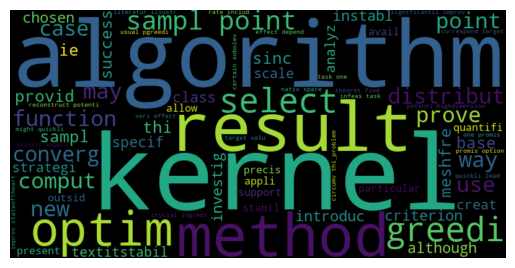

Top authors in community 165: https://openalex.org/A5073837806, https://openalex.org/A5087671511, https://openalex.org/A5047250646


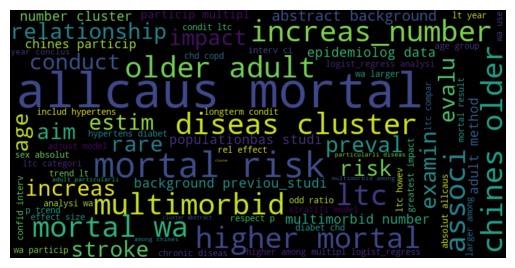

Top authors in community 166: https://openalex.org/A5045901985, https://openalex.org/A5040442974, https://openalex.org/A5020306816


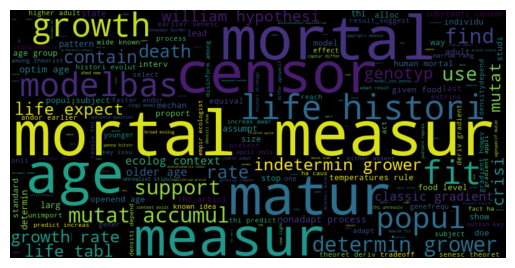

Top authors in community 167: https://openalex.org/A5028701322, https://openalex.org/A5028701322, https://openalex.org/A5028701322


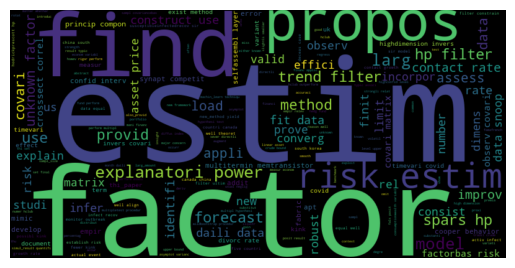

Top authors in community 168: https://openalex.org/A5085415365, https://openalex.org/A5085415365, https://openalex.org/A5085415365


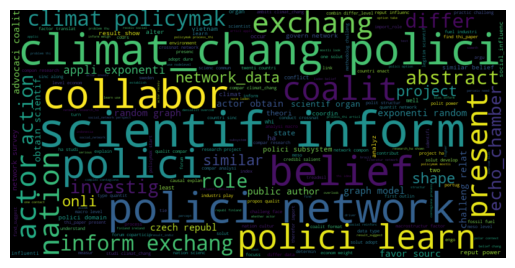

Top authors in community 169: https://openalex.org/A5084285249, https://openalex.org/A5084285249, https://openalex.org/A5084285249


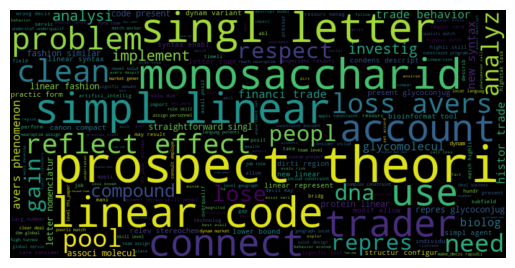

Top authors in community 170: https://openalex.org/A5054642987, https://openalex.org/A5054642987, https://openalex.org/A5054642987


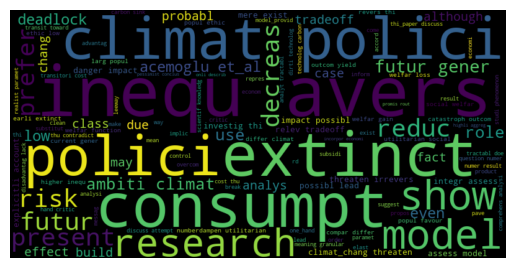

Top authors in community 171: https://openalex.org/A5053148541, https://openalex.org/A5053148541, https://openalex.org/A5038446603


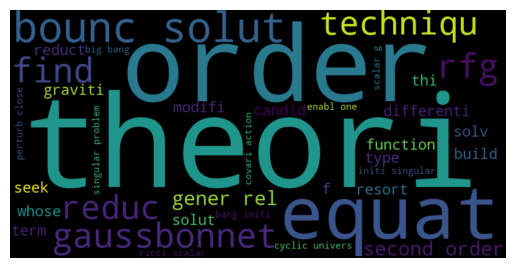

Top authors in community 172: https://openalex.org/A5017836070, https://openalex.org/A5013698019, https://openalex.org/A5058488234


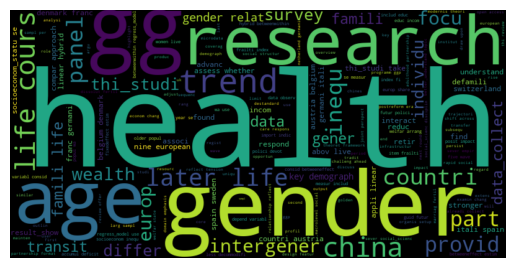

Top authors in community 173: https://openalex.org/A5042391987, https://openalex.org/A5042391987, https://openalex.org/A5042391987


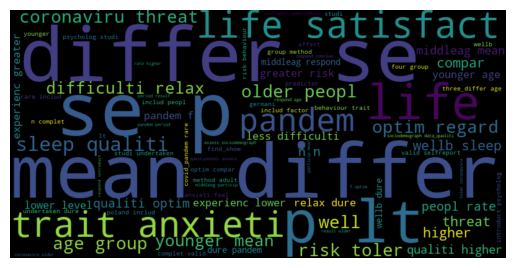

Top authors in community 174: https://openalex.org/A5027359112, https://openalex.org/A5017911927, https://openalex.org/A5030377679


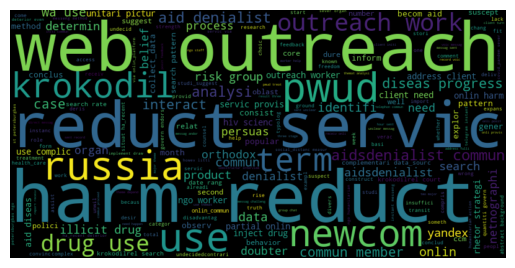

Top authors in community 175: https://openalex.org/A5046955571, https://openalex.org/A5046955571, https://openalex.org/A5046955571


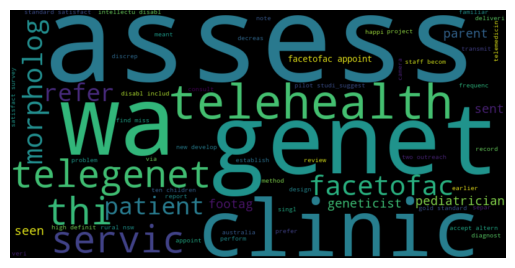

Top authors in community 176: https://openalex.org/A5088392939, https://openalex.org/A5001559036, https://openalex.org/A5089384499


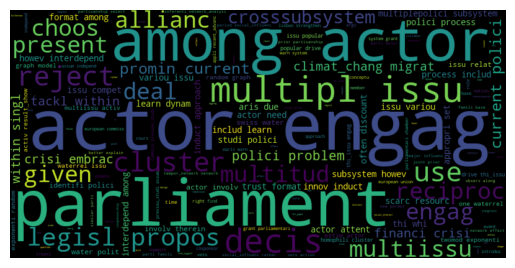

Top authors in community 177: https://openalex.org/A5030086495, https://openalex.org/A5030086495, https://openalex.org/A5032278939


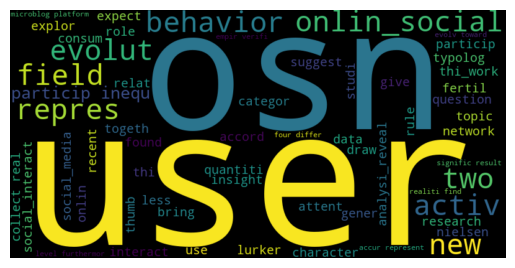

Top authors in community 178: https://openalex.org/A5036057602, https://openalex.org/A5025069859, https://openalex.org/A5035407958


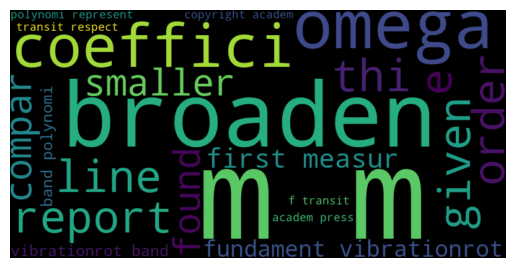

Top authors in community 179: https://openalex.org/A5009614805, https://openalex.org/A5008496685, https://openalex.org/A5002702320


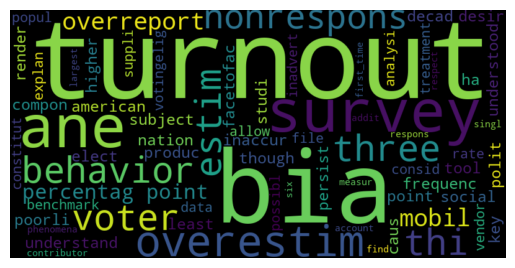

Top authors in community 180: https://openalex.org/A5057360766, https://openalex.org/A5007077429


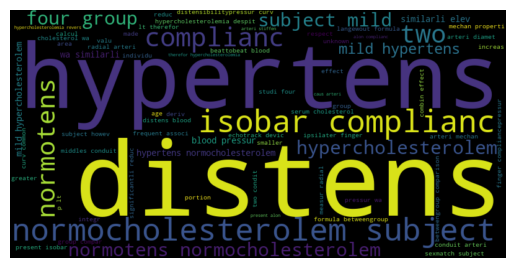

Top authors in community 181: https://openalex.org/A5073089282, https://openalex.org/A5084756058, https://openalex.org/A5065859301


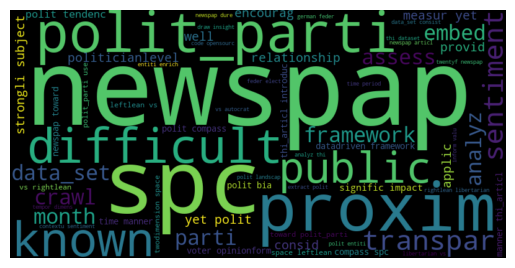

Top authors in community 182: https://openalex.org/A5009541437, https://openalex.org/A5045947853, https://openalex.org/A5090115852


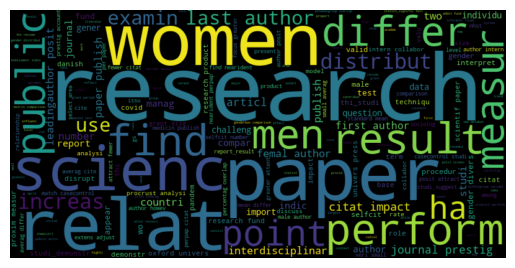

Top authors in community 183: https://openalex.org/A5064171835, https://openalex.org/A5064171835, https://openalex.org/A5064171835


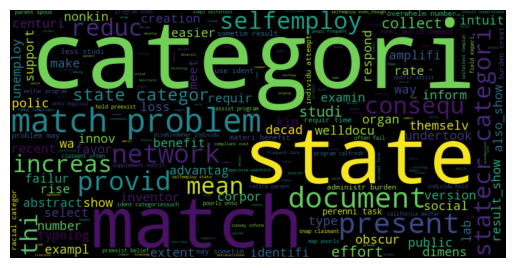

Top authors in community 184: https://openalex.org/A5068713525, https://openalex.org/A5068713525, https://openalex.org/A5068713525


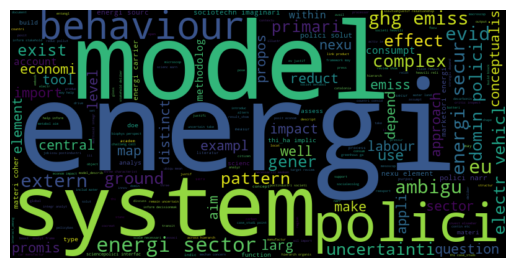

Top authors in community 185: https://openalex.org/A5052905268, https://openalex.org/A5052905268, https://openalex.org/A5052905268


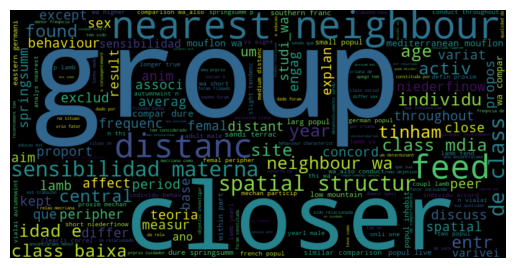

Top authors in community 186: https://openalex.org/A5084860941, https://openalex.org/A5062103492, https://openalex.org/A5062103492


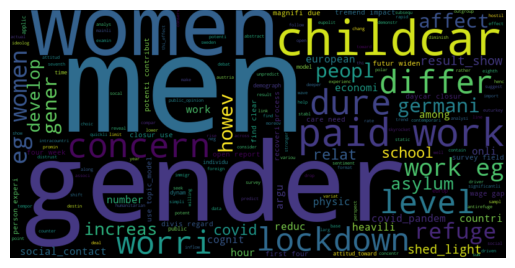

Top authors in community 187: https://openalex.org/A5026982890, https://openalex.org/A5080335789, https://openalex.org/A5003546846


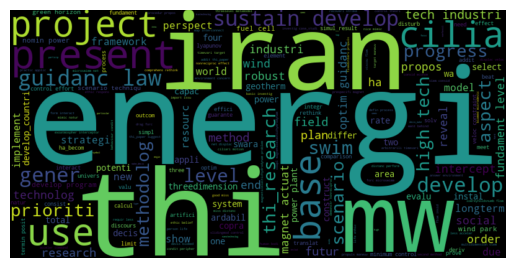

Top authors in community 188: https://openalex.org/A5010053907, https://openalex.org/A5010053907, https://openalex.org/A5010053907


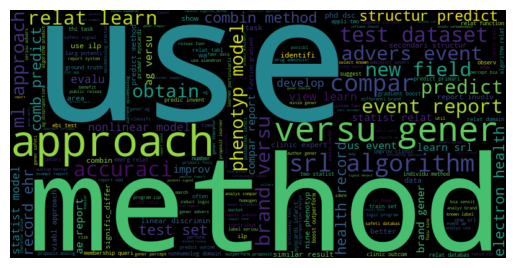

Top authors in community 189: https://openalex.org/A5068251706, https://openalex.org/A5068251706, https://openalex.org/A5068251706


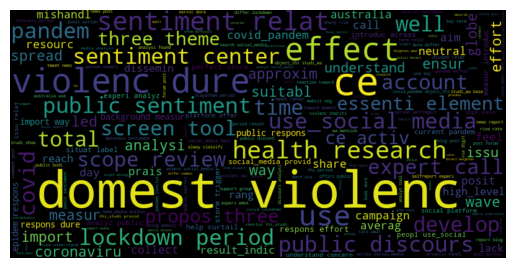

Top authors in community 190: https://openalex.org/A5034089601, https://openalex.org/A5034089601, https://openalex.org/A5011283595


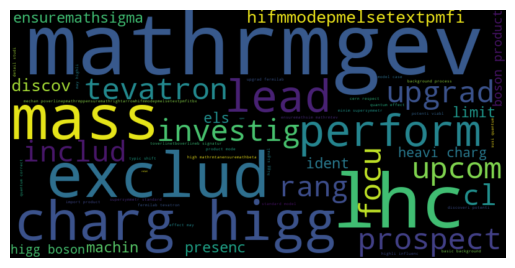

Top authors in community 191: https://openalex.org/A5034869512, https://openalex.org/A5073745340, https://openalex.org/A5073745340


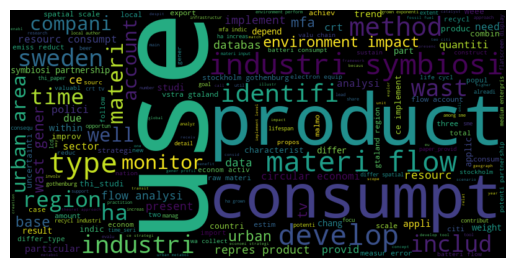

Top authors in community 192: https://openalex.org/A5065320504, https://openalex.org/A5065320504, https://openalex.org/A5065320504


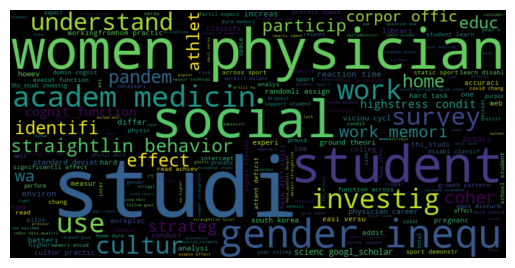

Top authors in community 193: https://openalex.org/A5090619385, https://openalex.org/A5090619385, https://openalex.org/A5090619385


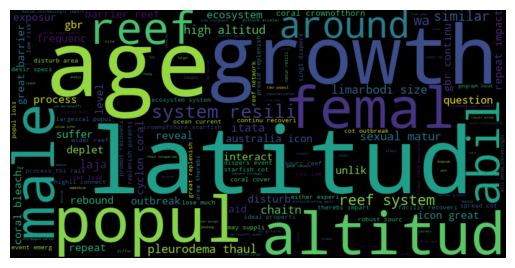

Top authors in community 194: https://openalex.org/A5089951210, https://openalex.org/A5089951210, https://openalex.org/A5031719134


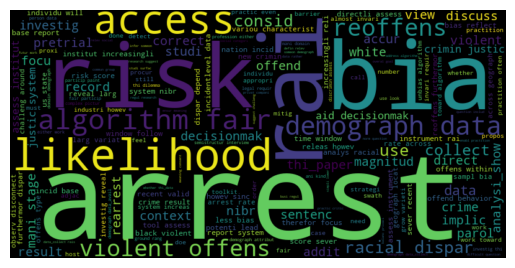

Top authors in community 195: https://openalex.org/A5035786206, https://openalex.org/A5035786206, https://openalex.org/A5008759018


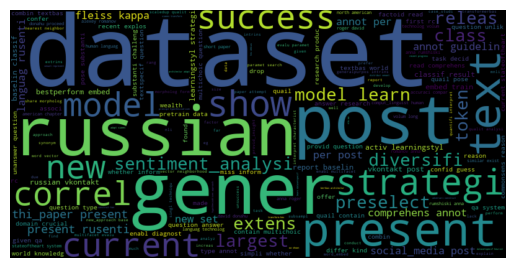

Top authors in community 196: https://openalex.org/A5039256697, https://openalex.org/A5039256697, https://openalex.org/A5039256697


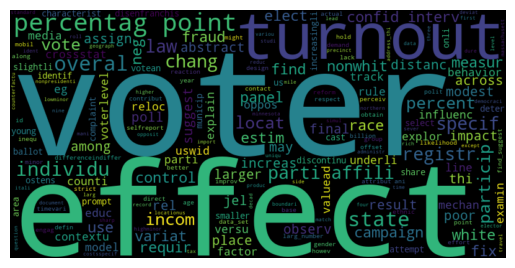

Top authors in community 197: https://openalex.org/A5074208278, https://openalex.org/A5017408918, https://openalex.org/A5017408918


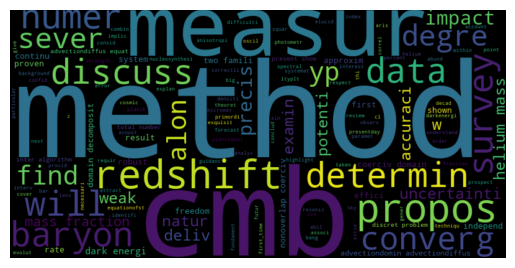

Top authors in community 198: https://openalex.org/A5049262683, https://openalex.org/A5049262683, https://openalex.org/A5049262683


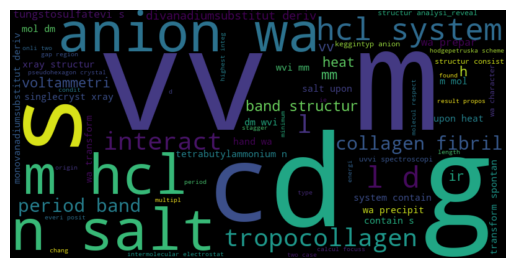

Top authors in community 199: https://openalex.org/A5069640989, https://openalex.org/A5069640989, https://openalex.org/A5069583485


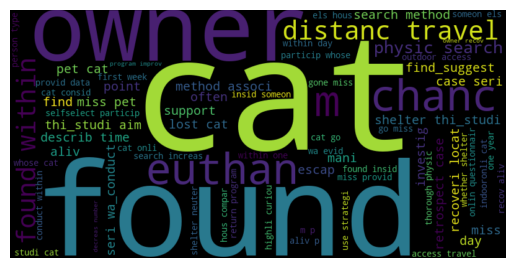

Top authors in community 200: https://openalex.org/A5071803353, https://openalex.org/A5030374143, https://openalex.org/A5002408562


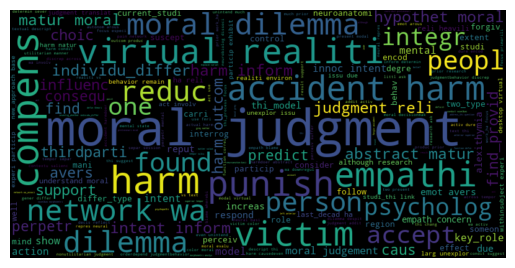

Top authors in community 201: https://openalex.org/A5050902528, https://openalex.org/A5050902528, https://openalex.org/A5050902528


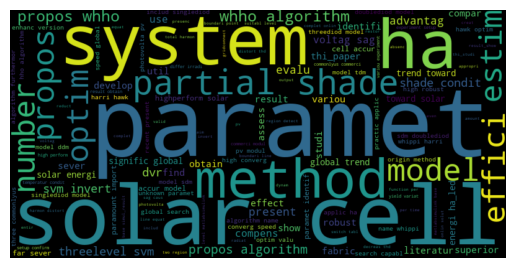

Top authors in community 202: https://openalex.org/A5057252498, https://openalex.org/A5057252498, https://openalex.org/A5070367582


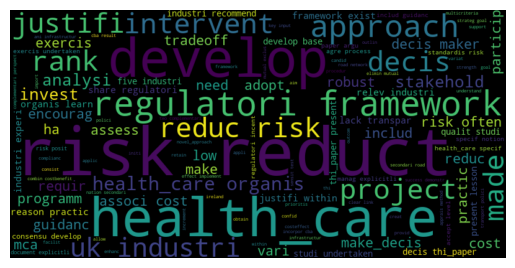

Top authors in community 203: https://openalex.org/A5077745776, https://openalex.org/A5077745776, https://openalex.org/A5079869230


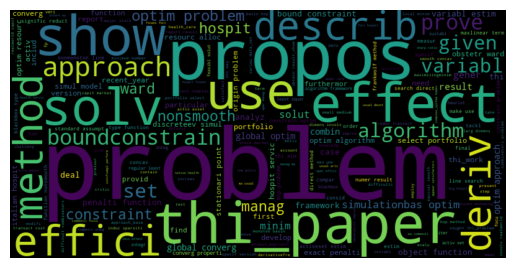

Top authors in community 204: https://openalex.org/A5040000503, https://openalex.org/A5040000503, https://openalex.org/A5040000503


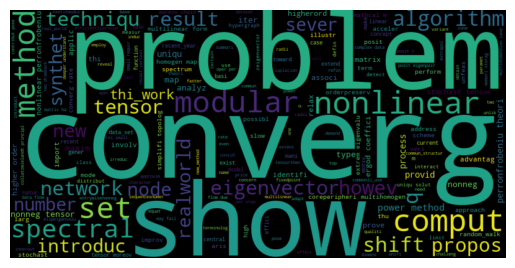

Top authors in community 205: https://openalex.org/A5043752696, https://openalex.org/A5043752696, https://openalex.org/A5043752696


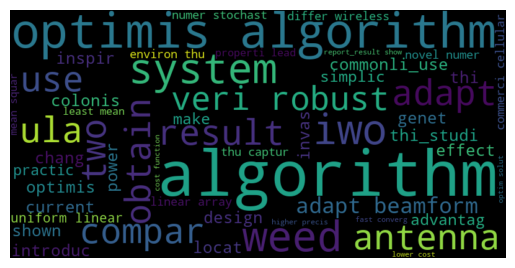

Top authors in community 206: https://openalex.org/A5019800917, https://openalex.org/A5066136171, https://openalex.org/A5085138903


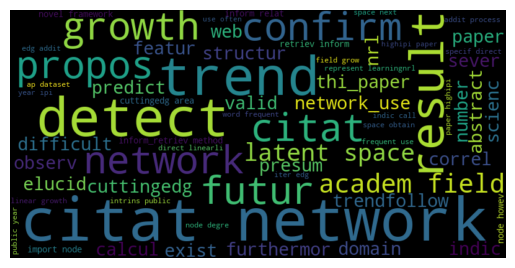

Top authors in community 207: https://openalex.org/A5071470375, https://openalex.org/A5021614922, https://openalex.org/A5067094699


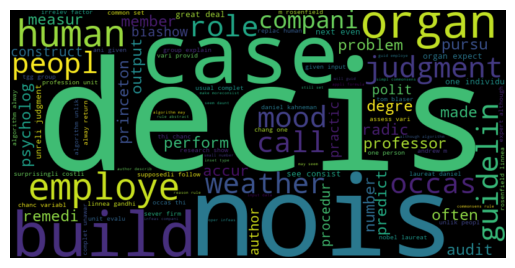

Top authors in community 208: https://openalex.org/A5003264876, https://openalex.org/A5019373396, https://openalex.org/A5044875858


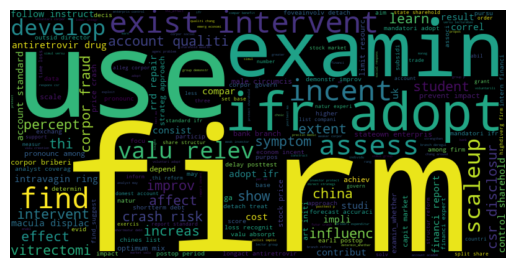

Top authors in community 209: https://openalex.org/A5034693159, https://openalex.org/A5034693159, https://openalex.org/A5034693159


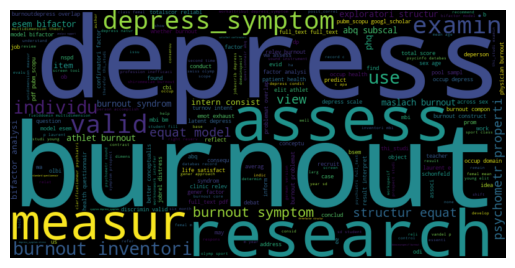

Top authors in community 210: https://openalex.org/A5039114051, https://openalex.org/A5039114051, https://openalex.org/A5039114051


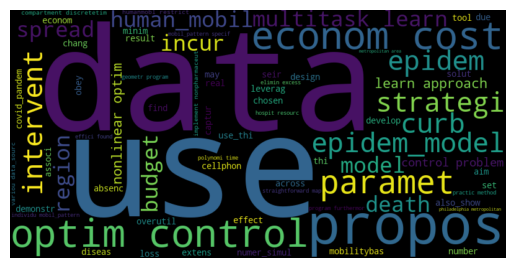

Top authors in community 211: https://openalex.org/A5057261458, https://openalex.org/A5058502061, https://openalex.org/A5039966234


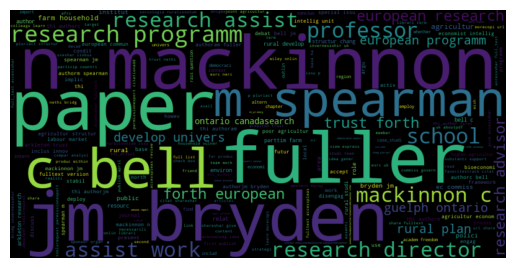

Top authors in community 212: https://openalex.org/A5085714892, https://openalex.org/A5085714892, https://openalex.org/A5085714892


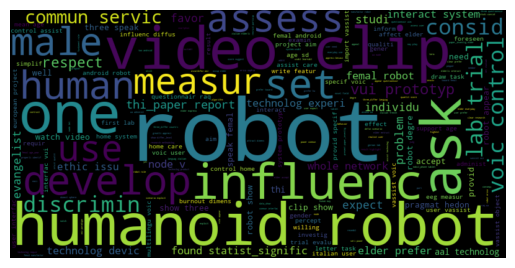

Top authors in community 213: https://openalex.org/A5084267145, https://openalex.org/A5084267145, https://openalex.org/A5084267145


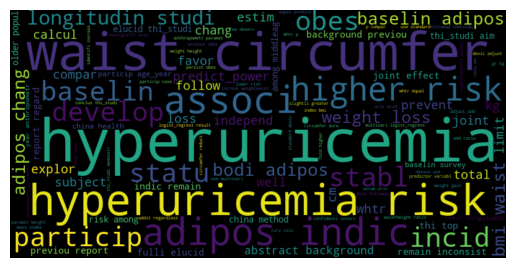

Top authors in community 214: https://openalex.org/A5082883074, https://openalex.org/A5058072635, https://openalex.org/A5053334802


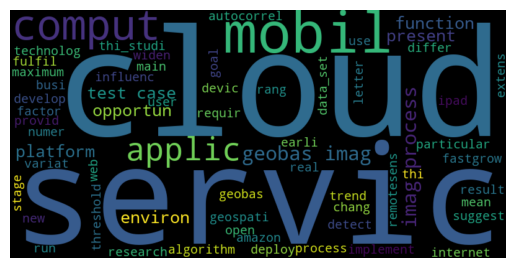

Top authors in community 215: https://openalex.org/A5029225859, https://openalex.org/A5030664816


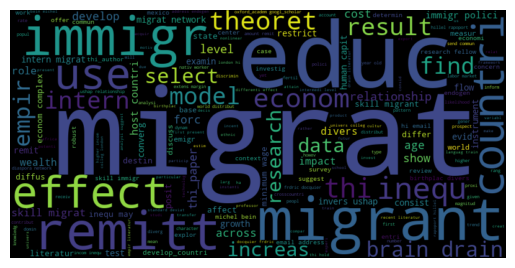

Top authors in community 216: https://openalex.org/A5056467893, https://openalex.org/A5056467893, https://openalex.org/A5056467893


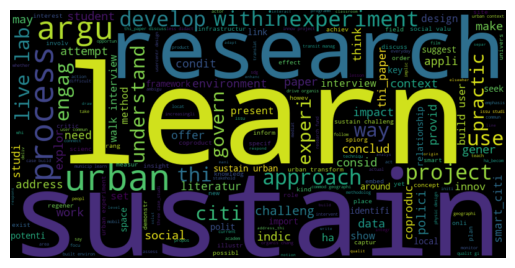

Top authors in community 217: https://openalex.org/A5043251311, https://openalex.org/A5043251311, https://openalex.org/A5043251311


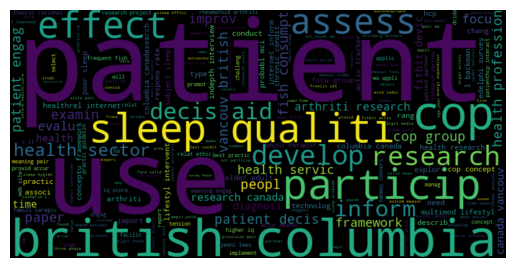

Top authors in community 218: https://openalex.org/A5007626204, https://openalex.org/A5007626204, https://openalex.org/A5007626204


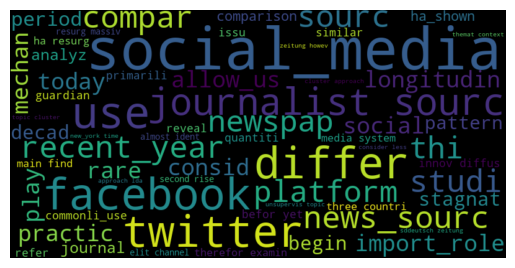

Top authors in community 219: https://openalex.org/A5021205874, https://openalex.org/A5045412540, https://openalex.org/A5090031720


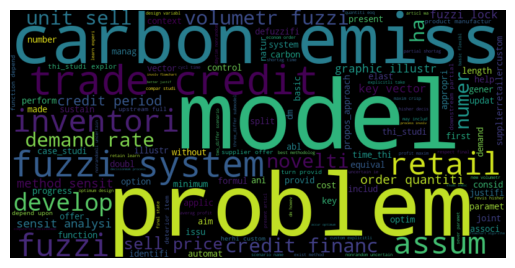

Top authors in community 220: https://openalex.org/A5030340672, https://openalex.org/A5030340672, https://openalex.org/A5078430868


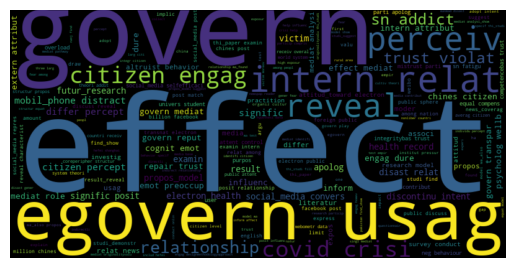

Top authors in community 221: https://openalex.org/A5050485733, https://openalex.org/A5050485733, https://openalex.org/A5050485733


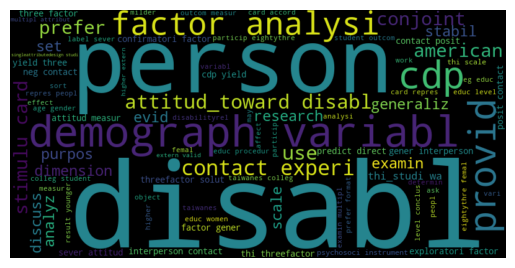

Top authors in community 222: https://openalex.org/A5045925919, https://openalex.org/A5045925919, https://openalex.org/A5082286074


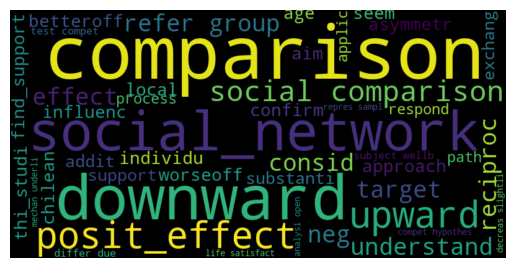

Top authors in community 223: https://openalex.org/A5075356239, https://openalex.org/A5066195010, https://openalex.org/A5014026767


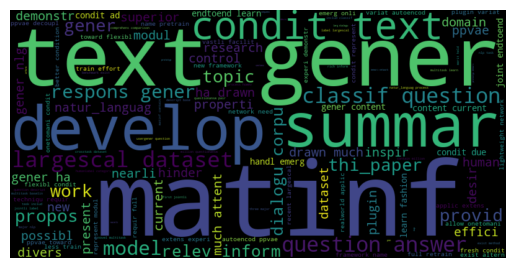

Top authors in community 224: https://openalex.org/A5037479075, https://openalex.org/A5065789784, https://openalex.org/A5049055745


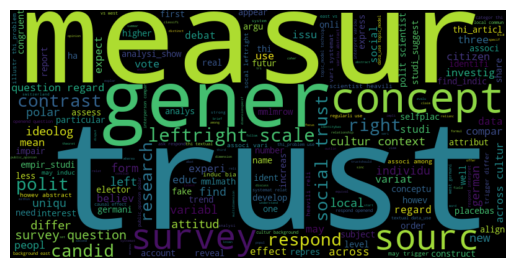

Top authors in community 225: https://openalex.org/A5028306705, https://openalex.org/A5028306705, https://openalex.org/A5028306705


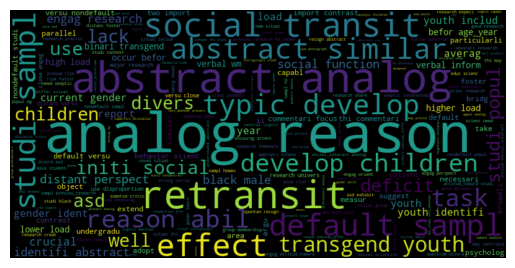

Top authors in community 226: https://openalex.org/A5063325475, https://openalex.org/A5063325475, https://openalex.org/A5063325475


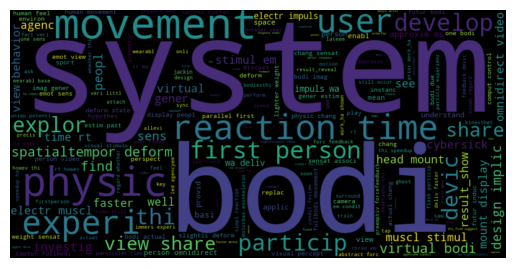

Top authors in community 227: https://openalex.org/A5071088094, https://openalex.org/A5071088094, https://openalex.org/A5071088094


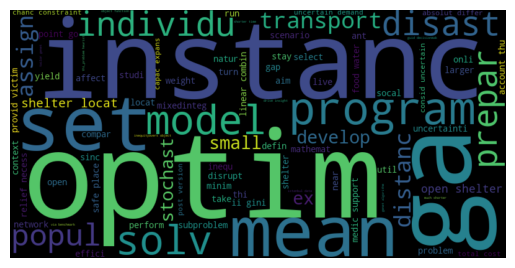

Top authors in community 228: https://openalex.org/A5058340908, https://openalex.org/A5087452627, https://openalex.org/A5042614566


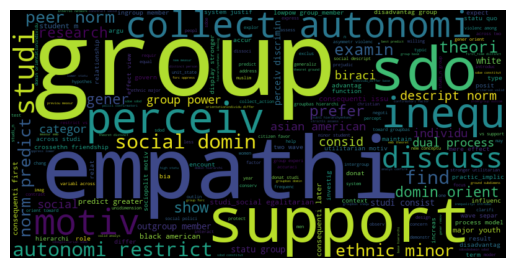

Top authors in community 230: https://openalex.org/A5084222212, https://openalex.org/A5084222212, https://openalex.org/A5084222212


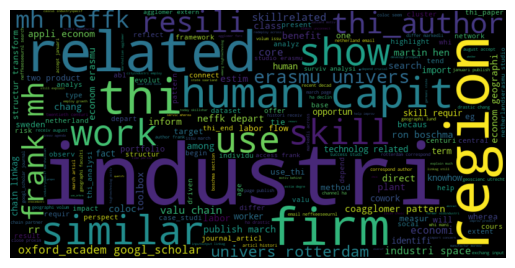

Top authors in community 231: https://openalex.org/A5032934166, https://openalex.org/A5032934166, https://openalex.org/A5032934166


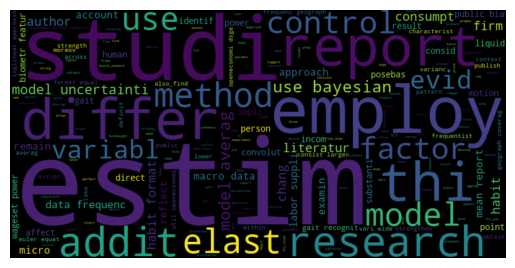

Top authors in community 232: https://openalex.org/A5054887365, https://openalex.org/A5054887365, https://openalex.org/A5054887365


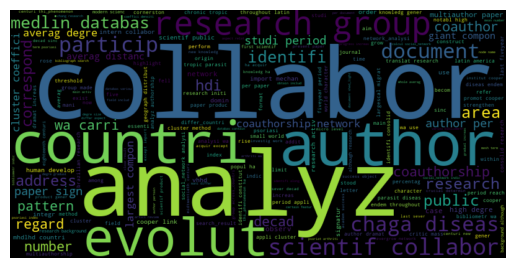

Top authors in community 233: https://openalex.org/A5033830347, https://openalex.org/A5033830347, https://openalex.org/A5033830347


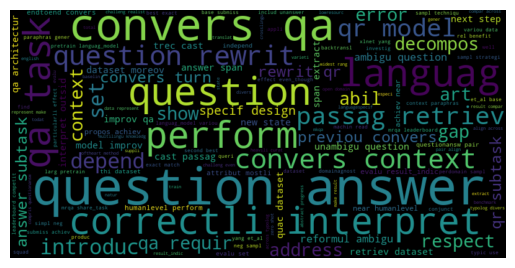

Top authors in community 234: https://openalex.org/A5001884064, https://openalex.org/A5001884064, https://openalex.org/A5001884064


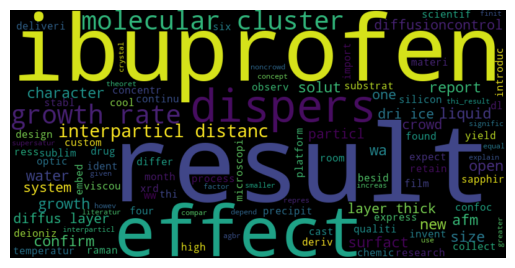

Top authors in community 235: https://openalex.org/A5033299992, https://openalex.org/A5033299992, https://openalex.org/A5072999287


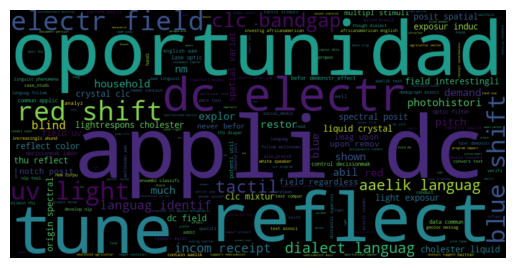

Top authors in community 236: https://openalex.org/A5008800832, https://openalex.org/A5008800832, https://openalex.org/A5008800832


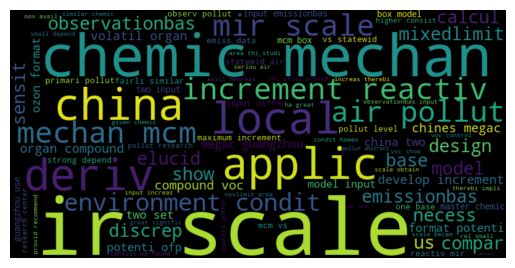

Top authors in community 237: https://openalex.org/A5024114692, https://openalex.org/A5028067869, https://openalex.org/A5043123329


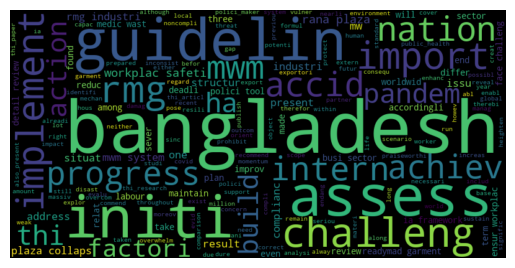

Top authors in community 238: https://openalex.org/A5037441540, https://openalex.org/A5037441540, https://openalex.org/A5037441540


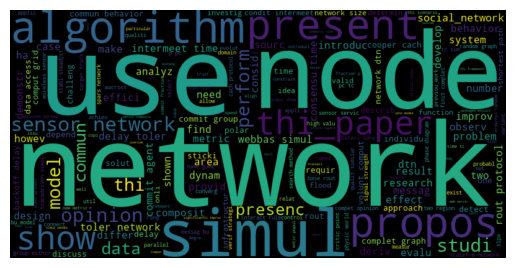

Top authors in community 239: https://openalex.org/A5082225935, https://openalex.org/A5082225935, https://openalex.org/A5082225935


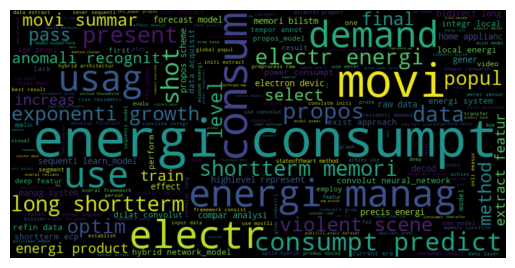

Top authors in community 240: https://openalex.org/A5000747784, https://openalex.org/A5000747784, https://openalex.org/A5000747784


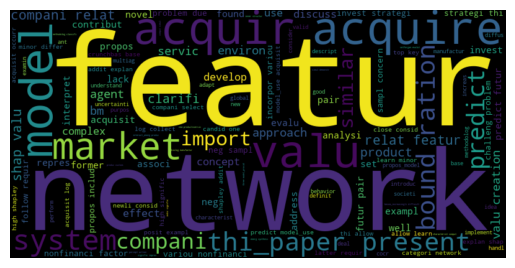

Top authors in community 241: https://openalex.org/A5063339619, https://openalex.org/A5063339619, https://openalex.org/A5063339619


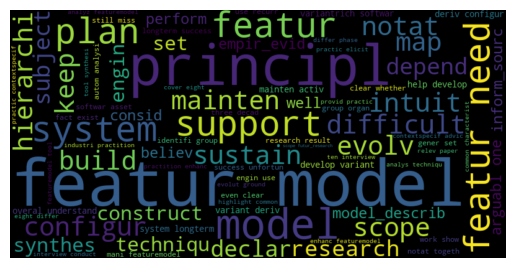

Top authors in community 242: https://openalex.org/A5044809751, https://openalex.org/A5042728295, https://openalex.org/A5048041198


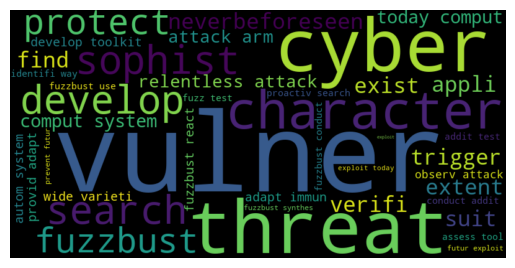

Top authors in community 243: https://openalex.org/A5007079605, https://openalex.org/A5021554912, https://openalex.org/A5017878990


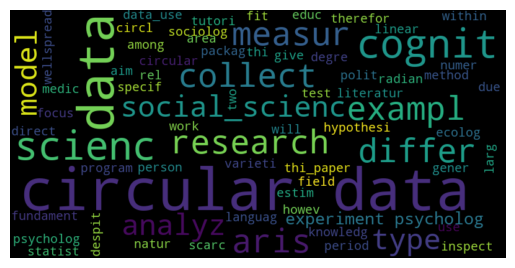

Top authors in community 244: https://openalex.org/A5066694574, https://openalex.org/A5059171727


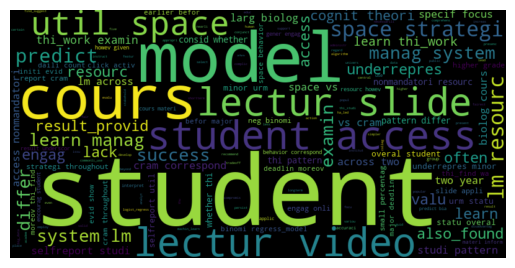

Top authors in community 245: https://openalex.org/A5047810054, https://openalex.org/A5047810054, https://openalex.org/A5002710722


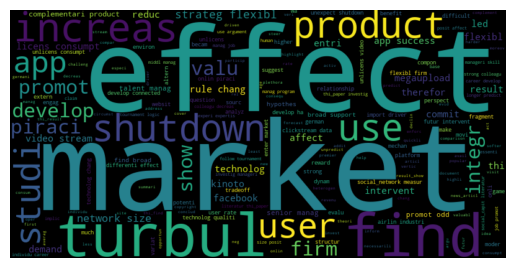

Top authors in community 246: https://openalex.org/A5052710947, https://openalex.org/A5052710947, https://openalex.org/A5052710947


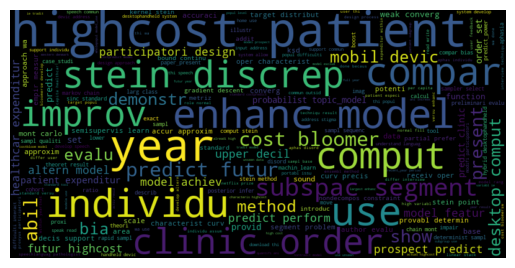

Top authors in community 247: https://openalex.org/A5018151279, https://openalex.org/A5018151279, https://openalex.org/A5018151279


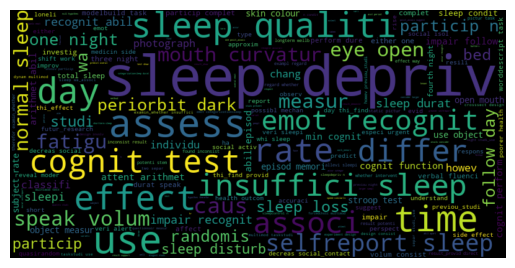

Top authors in community 248: https://openalex.org/A5048327571, https://openalex.org/A5048327571, https://openalex.org/A5048327571


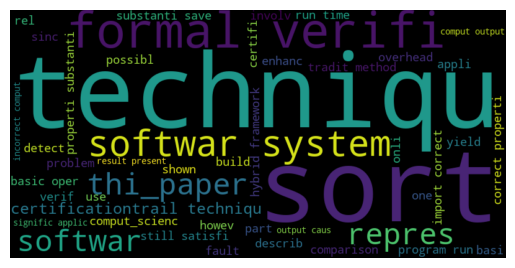

Top authors in community 249: https://openalex.org/A5079180422, https://openalex.org/A5054504492, https://openalex.org/A5012506346


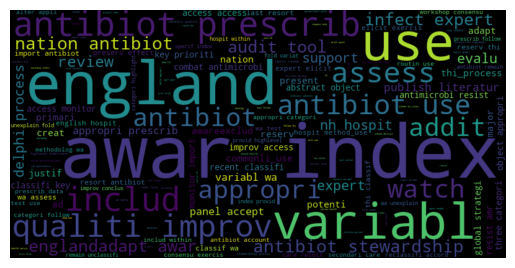

Top authors in community 250: https://openalex.org/A5030902266, https://openalex.org/A5030902266, https://openalex.org/A5019176699


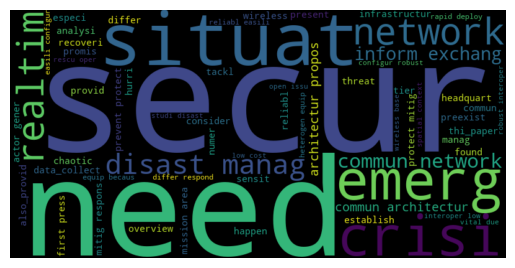

Top authors in community 251: https://openalex.org/A5074781940, https://openalex.org/A5077289750, https://openalex.org/A5038562202


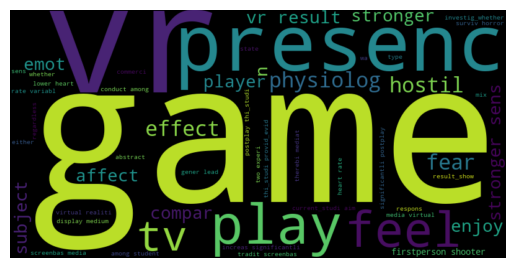

Top authors in community 252: https://openalex.org/A5041231901, https://openalex.org/A5045922841, https://openalex.org/A5051692037


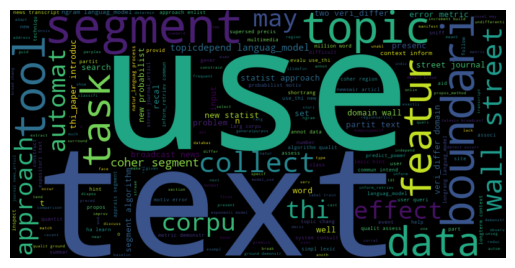

Top authors in community 253: https://openalex.org/A5064910304, https://openalex.org/A5064910304, https://openalex.org/A5064910304


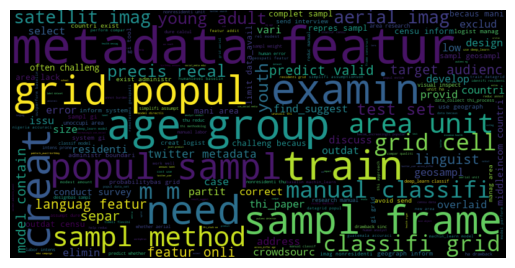

Top authors in community 254: https://openalex.org/A5078399314, https://openalex.org/A5078399314, https://openalex.org/A5066039364


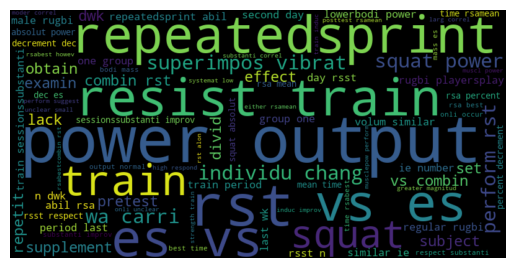

Top authors in community 255: https://openalex.org/A5007839126, https://openalex.org/A5040310678, https://openalex.org/A5008993367


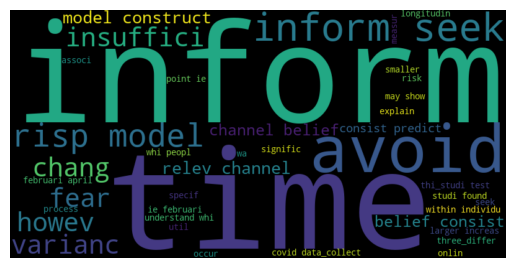

Top authors in community 256: https://openalex.org/A5091669275, https://openalex.org/A5050042134, https://openalex.org/A5001855584


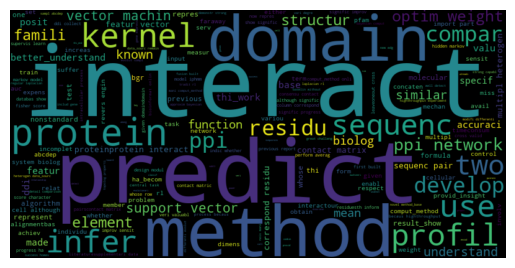

Top authors in community 257: https://openalex.org/A5028858881, https://openalex.org/A5028858881, https://openalex.org/A5028858881


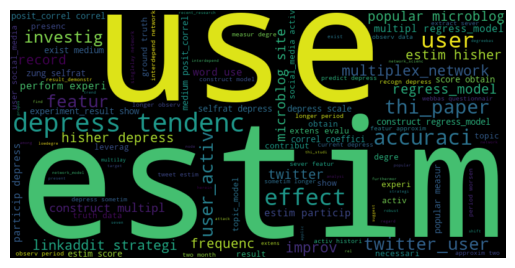

Top authors in community 258: https://openalex.org/A5019172487, https://openalex.org/A5019172487, https://openalex.org/A5019172487


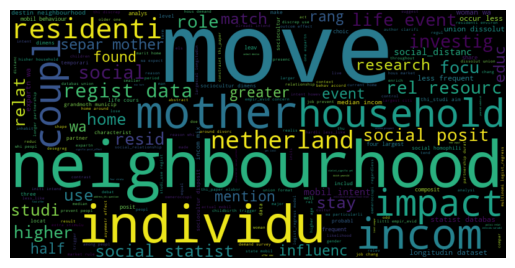

Top authors in community 259: https://openalex.org/A5047436850, https://openalex.org/A5047436850, https://openalex.org/A5047436850


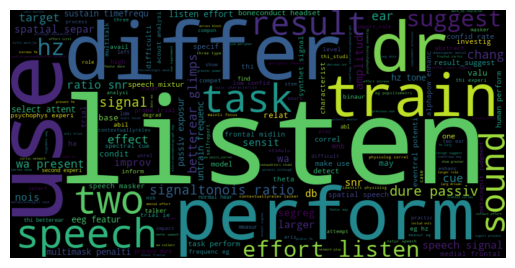

Top authors in community 260: https://openalex.org/A5062068291, https://openalex.org/A5062068291, https://openalex.org/A5062068291


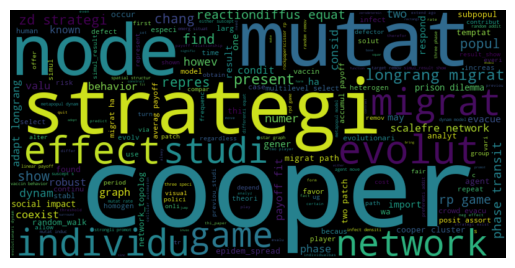

Top authors in community 261: https://openalex.org/A5080267104, https://openalex.org/A5080267104, https://openalex.org/A5080267104


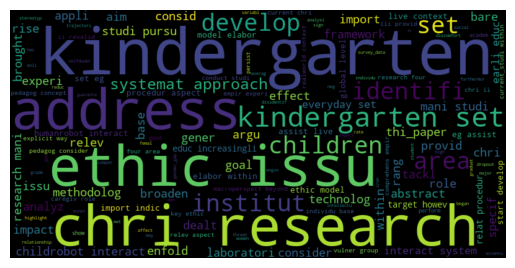

Top authors in community 262: https://openalex.org/A5034295818, https://openalex.org/A5034295818, https://openalex.org/A5024731704


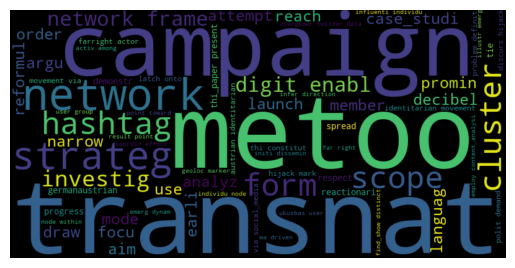

Top authors in community 263: https://openalex.org/A5068070625, https://openalex.org/A5022073192, https://openalex.org/A5032514633


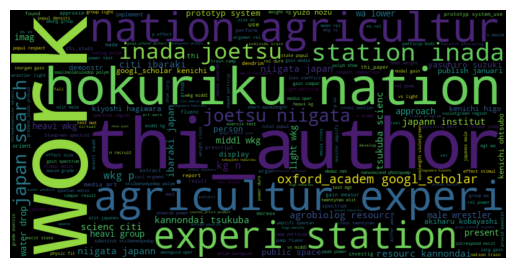

Top authors in community 264: https://openalex.org/A5073588329, https://openalex.org/A5073588329, https://openalex.org/A5073588329


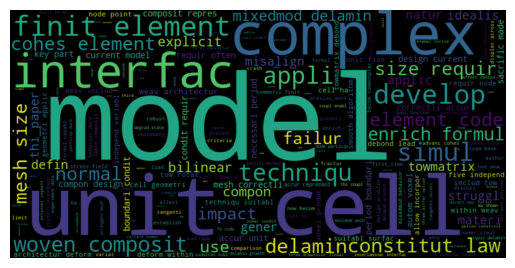

Top authors in community 265: https://openalex.org/A5076021081, https://openalex.org/A5076021081, https://openalex.org/A5076021081


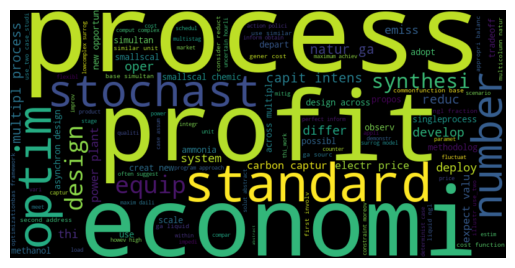

Top authors in community 266: https://openalex.org/A5042920997, https://openalex.org/A5016819382, https://openalex.org/A5016819382


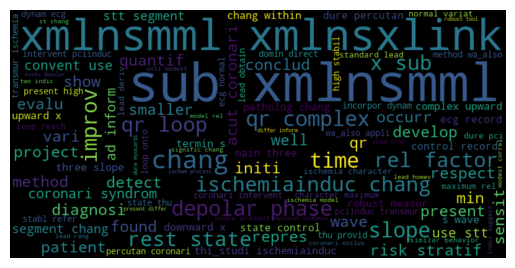

Top authors in community 267: https://openalex.org/A5065688490, https://openalex.org/A5017953596, https://openalex.org/A5084527753


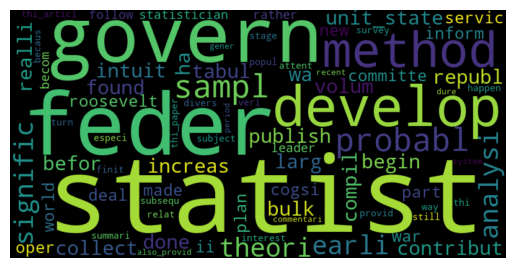

Top authors in community 268: https://openalex.org/A5042075947, https://openalex.org/A5023107270


In [13]:
# Sort the authors by degree in descending order
author_degree = df.sort_values('degree', ascending=False)

# Group the authors by community
grouped_authors = author_degree.groupby('community')

for community, tokens in community_docs.iterrows():
    # Create a WordCloud
    wordcloud = WordCloud(width=800, height=400).generate(' '.join(tokens['tokens']))

    # Display the WordCloud
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

    # Print the names of the top three authors in the community
    top_authors = grouped_authors.get_group(community)['author'].head(3)
    print(f"Top authors in community {community}: {', '.join(top_authors)}")